In [2]:
import numpy as np
import pandas as pd
# import scanpy.api as sc
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import os
%matplotlib inline

import scipy.stats as stats
import statsmodels.stats.multitest as multi

import matplotlib as mpl
mpl.rcParams['figure.facecolor'] = (1,1,1,1)
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

In [3]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis', transparent=False, 
                              frameon=False, fontsize=20)

import matplotlib as mpl
# 2 lines below solved the facecolor problem.
# mpl.rcParams['figure.facecolor'] = 'white'
mpl.rcParams['figure.facecolor'] = (1,1,1,1)
sc.settings.autosave = True
sc.logging.print_versions()

version = '210711_merged_thymoma_MG21.22.23.03'
os.makedirs('./scanpy/{}/graph'.format(version), exist_ok=True)

# file_mat = 'F1314_200323_222536_summary/10425963-2_3DE_genematrix.csv'

results_file = './scanpy/{}/merge.h5ad'.format(version)
results_raw_file = './scanpy/{}/merge.raw.h5ad'.format(version)

# for cellphonedb
raw_matrix = './scanpy/{}/merge.raw.tsv'.format(version)

sc.settings.figdir = './scanpy/{}/graph'.format(version)
sc.settings.cachedir = './scanpy/{}/cache'.format(version)
# %config InlineBackend.figure_format = 'retina'

-----
anndata     0.7.6
scanpy      1.7.2
sinfo       0.3.1
-----
PIL                 8.1.2
anndata             0.7.6
backcall            0.2.0
cffi                1.14.5
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.1
decorator           4.4.2
get_version         2.1
google              NA
h5py                2.10.0
igraph              0.9.1
ipykernel           5.3.4
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.17.2
joblib              1.0.1
kiwisolver          1.3.1
legacy_api_wrap     1.2
leidenalg           0.8.4
llvmlite            0.34.0
matplotlib          3.4.1
mpl_toolkits        NA
natsort             7.1.1
numba               0.51.0
numexpr             2.7.3
numpy               1.20.2
packaging           20.9
pandas              1.2.4
parso               0.7.0
pexpect             4.8.0
pickleshare         0.7.5
pkg_resources       NA
prompt_toolkit      3.0.8
psutil              5.8.0
ptyproce

In [3]:
list_conditions = \
[['MG21', 'TE', 'Thymus', 'Stroma'],
['MG21', 'TL', 'Thymus', 'Lymphocytes'],
['MG22', 'TE', 'Thymus', 'Stroma'],
# ['MG22', 'TL', 'Tumor', 'Lymphocytes'],
['MG22', 'PL', 'Periphery', 'Lymphocytes'],
['MG03', 'TE', 'Thymus', 'Stroma'],
['MG03', 'TL', 'Thymus', 'Lymphocytes'],
['MG03', 'PT', 'Periphery', 'Stroma'],
['MG03', 'PB', 'Periphery', 'Lymphocytes'],
['MG23', 'TE', 'Thymus', 'Stroma']]

df_conditions = pd.DataFrame(list_conditions, columns=['individual', 'sample_type', 'site', 'fraction'])
df_conditions['sample'] = df_conditions['individual'] + '_' + df_conditions['sample_type']
df_conditions

,individual,sample_type,site,fraction,sample
0,MG21,TE,Thymus,Stroma,MG21_TE
1,MG21,TL,Thymus,Lymphocytes,MG21_TL
2,MG22,TE,Thymus,Stroma,MG22_TE
3,MG22,PL,Periphery,Lymphocytes,MG22_PL
4,MG03,TE,Thymus,Stroma,MG03_TE
5,MG03,TL,Thymus,Lymphocytes,MG03_TL
6,MG03,PT,Periphery,Stroma,MG03_PT
7,MG03,PB,Periphery,Lymphocytes,MG03_PB
8,MG23,TE,Thymus,Stroma,MG23_TE


In [4]:
list_odd_s = []
list_adata = []
f_root = './data/cellranger'
for pos,row in df_conditions.iterrows():
    f = '{r}/{s}/filtered_feature_bc_matrix.h5'.format(r=f_root, s=row['sample'])
    try:
        a = sc.read_10x_h5(f)
        a.obs['sample'] = row['sample']
        a.obs['sample_type'] = row['sample_type']
        a.obs['site'] = row['site']
        a.obs['fraction'] = row['fraction']
        print(a)
        list_adata.append(a)
    except:
        print(row['sample'])
        list_odd_s.append(row['sample'])

reading ./data/cellranger/MG21_TE/filtered_feature_bc_matrix.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:01)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
reading ./data/cellranger/MG21_TL/filtered_feature_bc_matrix.h5


AnnData object with n_obs × n_vars = 1527 × 36601
    obs: 'sample', 'sample_type', 'site', 'fraction'
    var: 'gene_ids', 'feature_types', 'genome'


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:07)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
reading ./data/cellranger/MG22_TE/filtered_feature_bc_matrix.h5


AnnData object with n_obs × n_vars = 11178 × 36601
    obs: 'sample', 'sample_type', 'site', 'fraction'
    var: 'gene_ids', 'feature_types', 'genome'


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:04)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
reading ./data/cellranger/MG22_PL/filtered_feature_bc_matrix.h5


AnnData object with n_obs × n_vars = 3853 × 36601
    obs: 'sample', 'sample_type', 'site', 'fraction'
    var: 'gene_ids', 'feature_types', 'genome'


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:08)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
reading ./data/cellranger/MG03_TE/filtered_feature_bc_matrix.h5


AnnData object with n_obs × n_vars = 12004 × 36601
    obs: 'sample', 'sample_type', 'site', 'fraction'
    var: 'gene_ids', 'feature_types', 'genome'


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:04)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
reading ./data/cellranger/MG03_TL/filtered_feature_bc_matrix.h5


AnnData object with n_obs × n_vars = 5520 × 36601
    obs: 'sample', 'sample_type', 'site', 'fraction'
    var: 'gene_ids', 'feature_types', 'genome'


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:08)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
reading ./data/cellranger/MG03_PT/filtered_feature_bc_matrix.h5


AnnData object with n_obs × n_vars = 8811 × 36601
    obs: 'sample', 'sample_type', 'site', 'fraction'
    var: 'gene_ids', 'feature_types', 'genome'


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:11)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
reading ./data/cellranger/MG03_PB/filtered_feature_bc_matrix.h5


AnnData object with n_obs × n_vars = 10916 × 36601
    obs: 'sample', 'sample_type', 'site', 'fraction'
    var: 'gene_ids', 'feature_types', 'genome'


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:09)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
reading ./data/cellranger/MG23_TE/filtered_feature_bc_matrix.h5


AnnData object with n_obs × n_vars = 8735 × 36601
    obs: 'sample', 'sample_type', 'site', 'fraction'
    var: 'gene_ids', 'feature_types', 'genome'


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:08)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 5898 × 36601
    obs: 'sample', 'sample_type', 'site', 'fraction'
    var: 'gene_ids', 'feature_types', 'genome'


In [5]:
def preprocess(adata):
#     blacklist = [x for x in adata.var.index if x.endswith('Ab')] + [""]
#     adata = adata[:, [x for x in adata.var.index if not x in blacklist]]
    
    sc.pp.filter_cells(adata, min_genes=200)
#     sc.pp.filter_genes(adata, min_cells=10)
    
    return adata

In [6]:
holder = []
for i, a in enumerate(list_adata):
    print(i)
    _a = a.copy()
    _a = preprocess(_a)
    _a.var_names_make_unique()
    _a.obs_names_make_unique()
    holder.append(_a)

adata = holder[0].concatenate(holder[1:], join='outer')

# adata.var becomes fuzzy and meaningless, so delete them all.
adata.var = adata.var.drop(adata.var.columns, axis=1)

# adata.obs['batch'] is waste of the memory.
adata.obs = adata.obs.drop(['batch'], axis=1)
adata.obs['individual'] = adata.obs['sample'].str.split('-').str.get(0)

adata.obs.index = [x.split('-')[0] for x in adata.obs.index]
adata.obs_names_make_unique()

# df_mart = pd.read_csv('data/mart_export_ensg_symbol.tsv', sep='\t', index_col=0)
# adata.var['ensembl'] = adata.var.index
# adata.var.index = list(df_mart.reindex([x.split('.')[0] for x in adata.var.index])['Gene name'])
# adata = adata[:, ~adata.var.index.isna()]
adata.var_names_make_unique()

adata.X = np.nan_to_num(adata.X)
adata.write(results_raw_file)


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0


filtered out 128 cells that have less than 200 genes expressed
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 7 cells that have less than 200 genes expressed
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 91 cells that have less than 200 genes expressed
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


3


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 21 cells that have less than 200 genes expressed
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


4


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 326 cells that have less than 200 genes expressed
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 20 cells that have less than 200 genes expressed
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


6


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


7


filtered out 5 cells that have less than 200 genes expressed
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


8


filtered out 826 cells that have less than 200 genes expressed
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'sample' as categorical
... storing 'sample_type' as categorical
... storing 'site' as categorical
... storing 'fraction' as categorical
... storing 'individual' as categorical


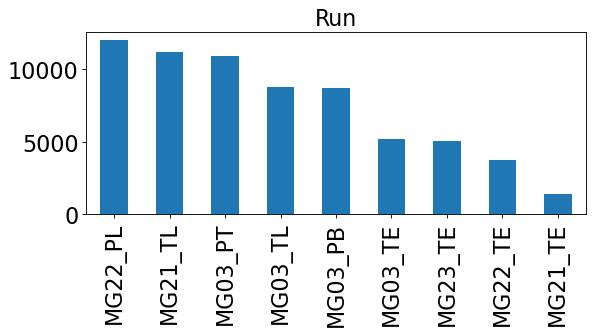

In [7]:
plt.figure(figsize=(8,3))
pd.Series(adata.obs['sample']).value_counts().plot(kind='bar')
plt.grid(None)
plt.title('Run')
plt.savefig(str(sc.settings.figdir) + '/run.pdf', bbox_inches='tight')

In [8]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [10]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
adata.raw = sc.pp.log1p(adata, copy=True)

normalizing by total count per cell
    finished (0:01:09): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


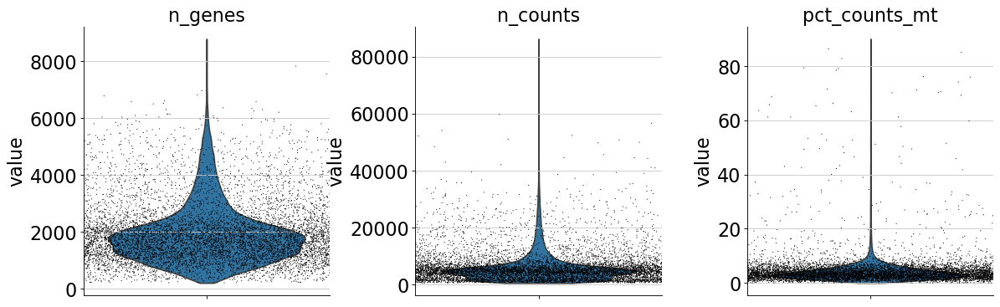

In [11]:
sc.pl.violin(adata, ['n_genes', 'n_counts', 'pct_counts_mt'],
             jitter=4, int=1, multi_panel=True, save='merge')

normalizing counts per cell
    finished (0:00:41)


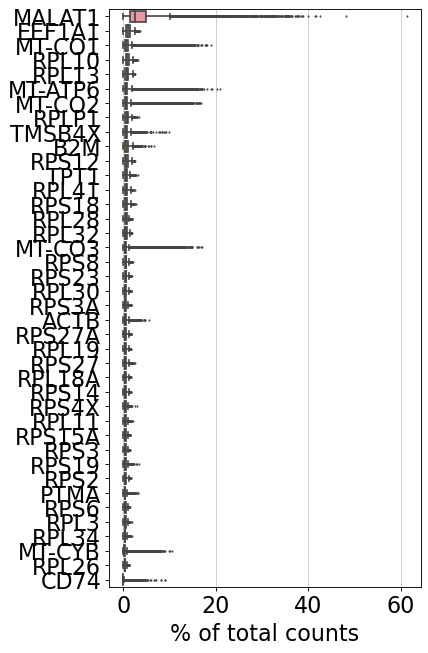

In [12]:
sc.pl.highest_expr_genes(adata, n_top=40)

In [13]:
adata = adata[adata.obs.pct_counts_mt < 20, :]

In [14]:
adata.obs['sample'].value_counts()

MG22_PL    11920
MG21_TL    11030
MG03_PT    10904
MG03_TL     8786
MG03_PB     8709
MG03_TE     5072
MG23_TE     4556
MG22_TE     3629
MG21_TE     1329
Name: sample, dtype: int64

extracting highly variable genes
    finished (0:00:01)


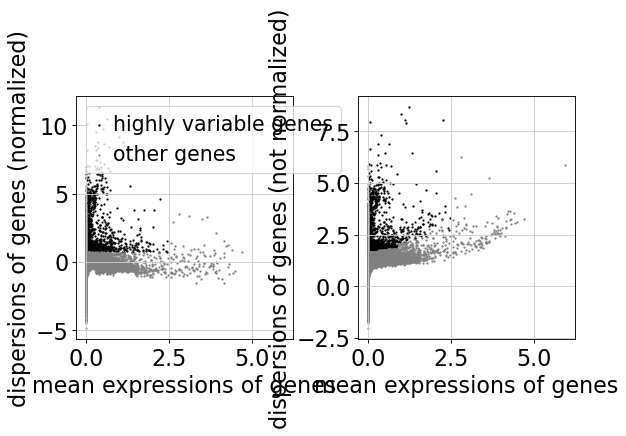

[1506, 36601]


In [15]:
filter_result = sc.pp.filter_genes_dispersion(
    adata.X, min_mean=0.0125, max_mean=2.5, min_disp=0.7)
sc.pl.filter_genes_dispersion(filter_result)
print([sum([i[0] for i in filter_result]),len(filter_result)])

In [16]:
print(adata.raw.shape)

(67018, 36601)


/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:375: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:00:24)


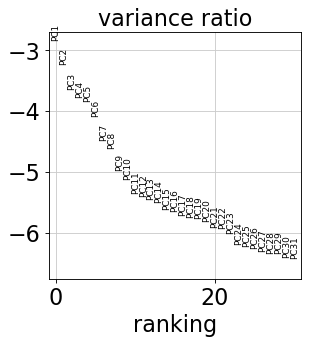

In [17]:
adata = adata[:, filter_result.gene_subset]
sc.pp.log1p(adata)
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata)
adata.obsm['X_pca'] *= -1  # multiply by -1 to match Seurat
sc.pl.pca_variance_ratio(adata, log=True)

In [18]:
sc.external.pp.bbknn(adata, batch_key='sample', n_pcs=50)
sc.tl.umap(adata, spread=1)
# sc.tl.leiden(adata, resolution=1)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:14)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:45)


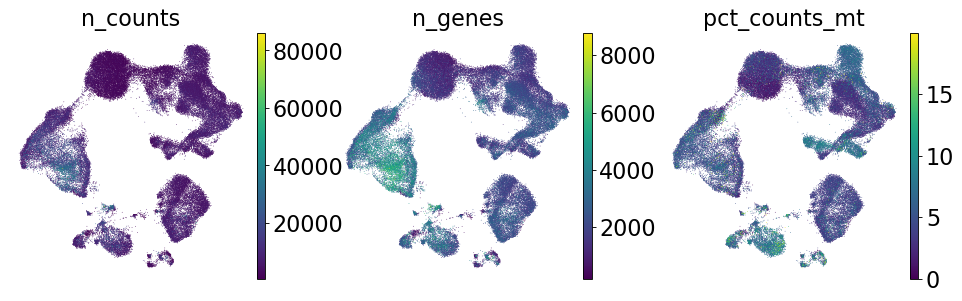

In [19]:
sc.pl.umap(adata, color=['n_counts', 'n_genes', 'pct_counts_mt'], save='qc')

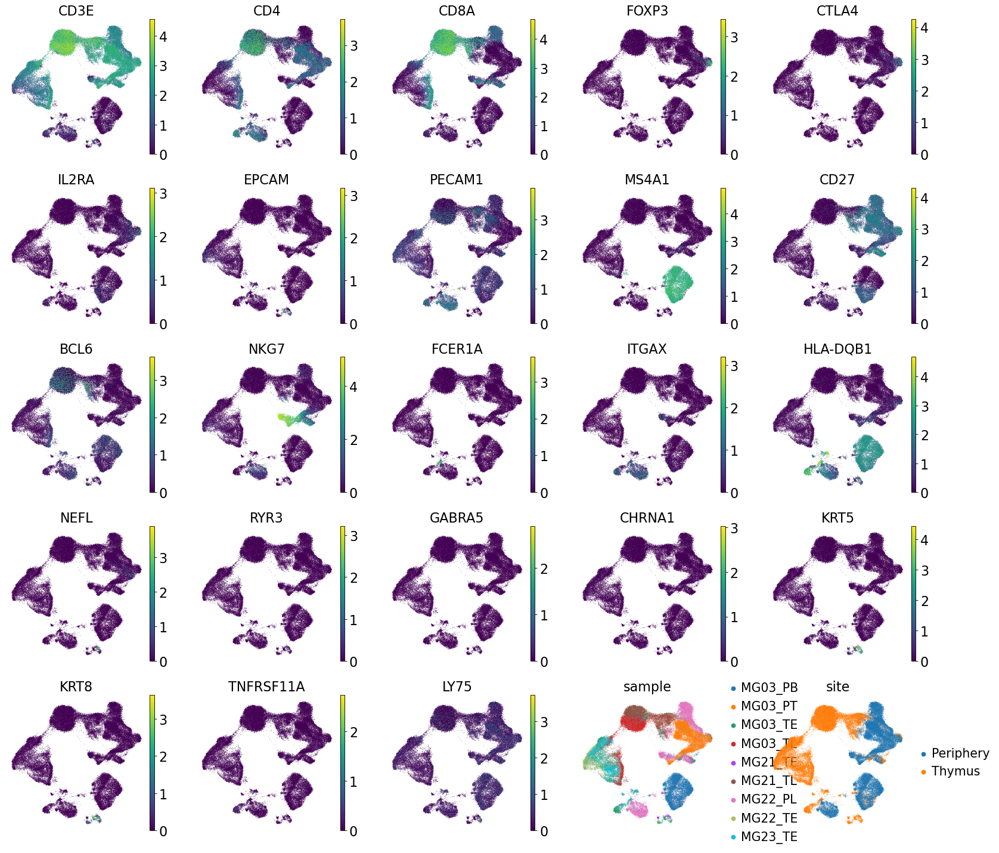

In [20]:
# ITGAX : CD11C
# CD27 : memory B
list_panel = ['CD3E', 'CD4', 'CD8A', 'FOXP3', 'CTLA4', 'IL2RA', 'EPCAM', 'PECAM1', 
                         'MS4A1', 'CD27', 'BCL6',
                         'NKG7', 'FCER1A', 'ITGAX', 'HLA-DQB1', 'NEFL', 'RYR3',
                         'GABRA5', 'CHRNA1', 
                         'KRT5', 'KRT8', 'TNFRSF11A', 'LY75']
sc.pl.umap(adata, color=list_panel + ['sample', 'site'],
          save='panel', ncols=5)

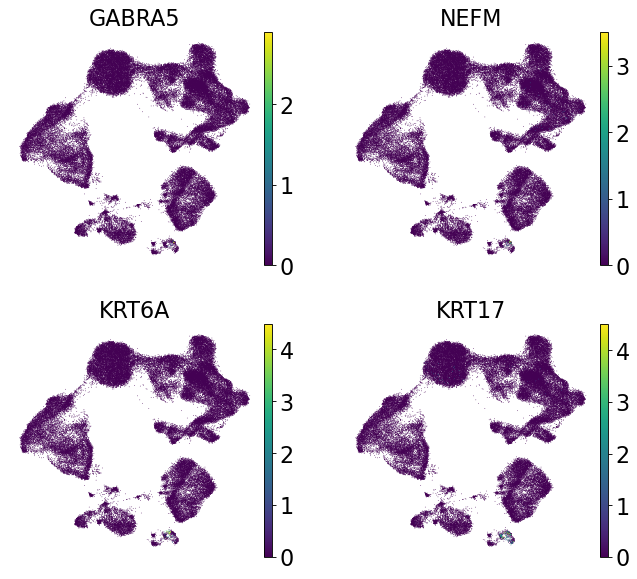

In [21]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['GABRA5', 'NEFM', 'KRT6A', 'KRT17'],
          save='panel_nmTEC', ncols=2)

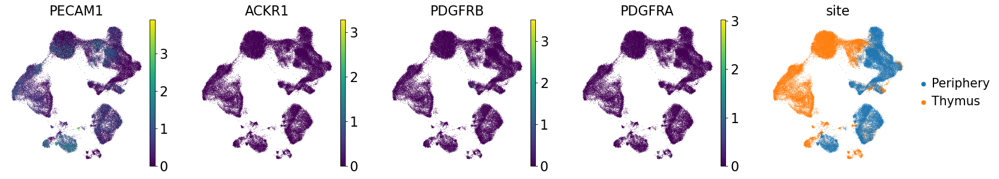

In [22]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['PECAM1', 'ACKR1', 'PDGFRB', 'PDGFRA', 'site'],
          save=False, ncols=5)

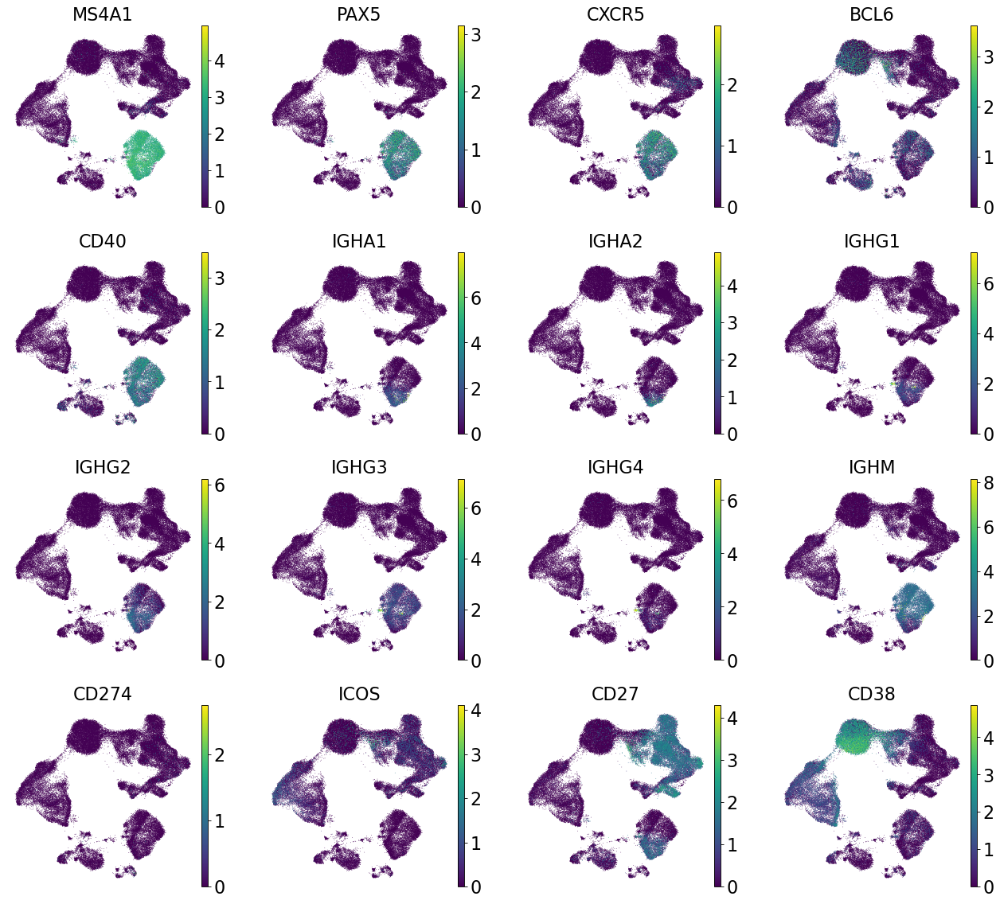

In [23]:
list_b_panel = ['MS4A1', 'PAX5', 'CXCR5', 'BCL6', 'CD40', 'IGHA1', 'IGHA2', 'IGHG1', 'IGHG2',
                         'IGHG3', 'IGHG4', 'IGHM', 'CD274', 'ICOS', 'CD27', 'CD38']

sc.pl.umap(adata, color=list_b_panel,
          save='panel_Bcell', ncols=4)

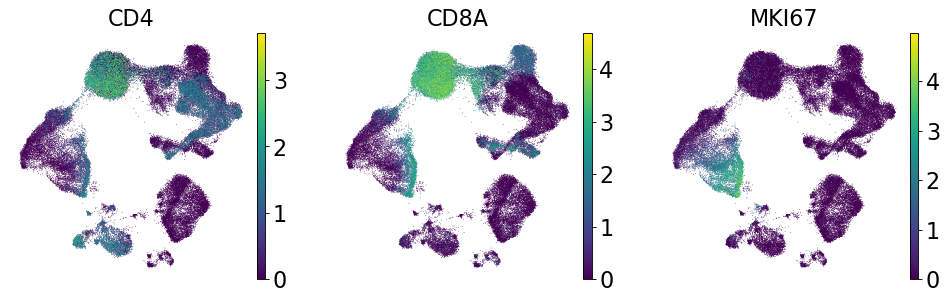

In [24]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['CD4', 'CD8A', 'MKI67'],
          save=False, ncols=5)

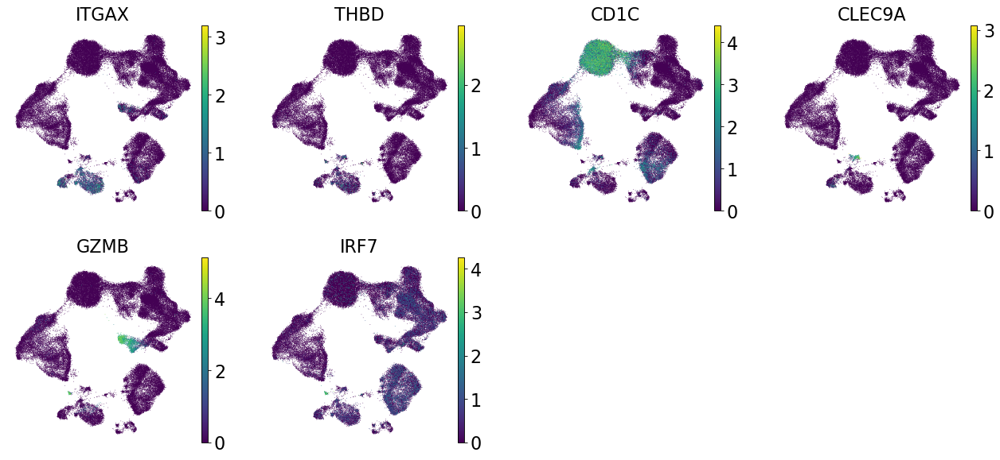

In [25]:
# CD141 : THBD
# CD11c : ITGAX

list_mono_panel = ['ITGAX', 'THBD', 'CD1C', 'CLEC9A', 'GZMB', 'IRF7']

sc.pl.umap(adata, color=list_mono_panel,
          save='panel_Mono', ncols=4)

In [26]:
sc.tl.leiden(adata, resolution=1.2)

running Leiden clustering
    finished: found 21 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:15)


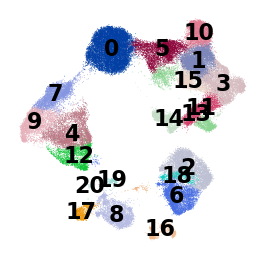

In [27]:
sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', frameon=False, save='leiden.pdf')

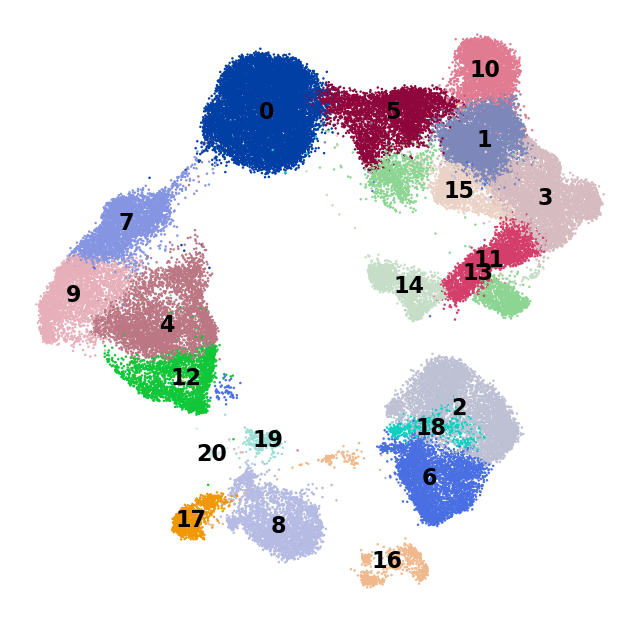

In [28]:
with plt.rc_context({"figure.figsize": (10, 10)}):
    sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', frameon=False, 
           save='leiden_large', s=20)

In [29]:
sc.tl.leiden(adata, resolution=0.3, restrict_to=('leiden', ['16']))

running Leiden clustering
    finished: found 25 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


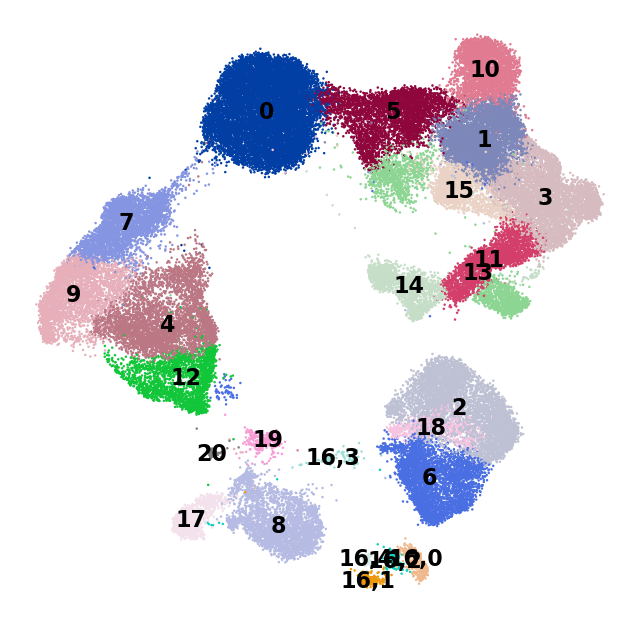

In [30]:
with plt.rc_context({"figure.figsize": (10, 10)}):
    sc.pl.umap(adata, color='leiden_R', legend_loc='on data', title='', frameon=False, 
           save='leiden_R', s=20)


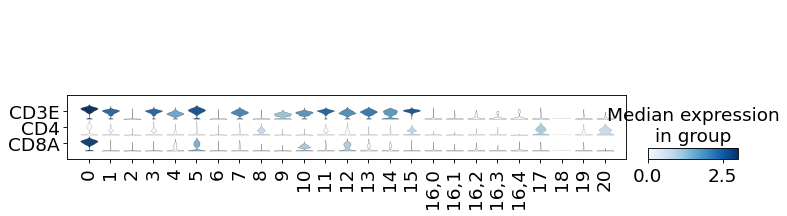

In [31]:
sc.pl.stacked_violin(adata, var_names=['CD3E', 'CD4', 'CD8A'], groupby='leiden_R', swap_axes=True)

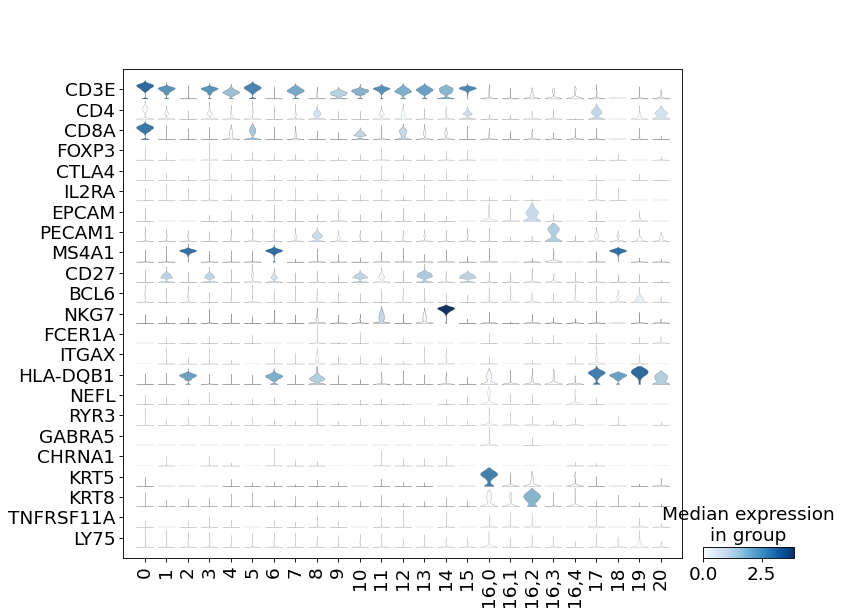

In [32]:
sc.pl.stacked_violin(adata, var_names=list_panel, groupby='leiden_R', swap_axes=True)

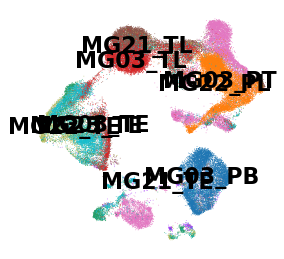

In [33]:
sc.pl.umap(adata, color='individual', legend_loc='on data', title='', 
           frameon=False, save='individual.pdf')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:11:29)


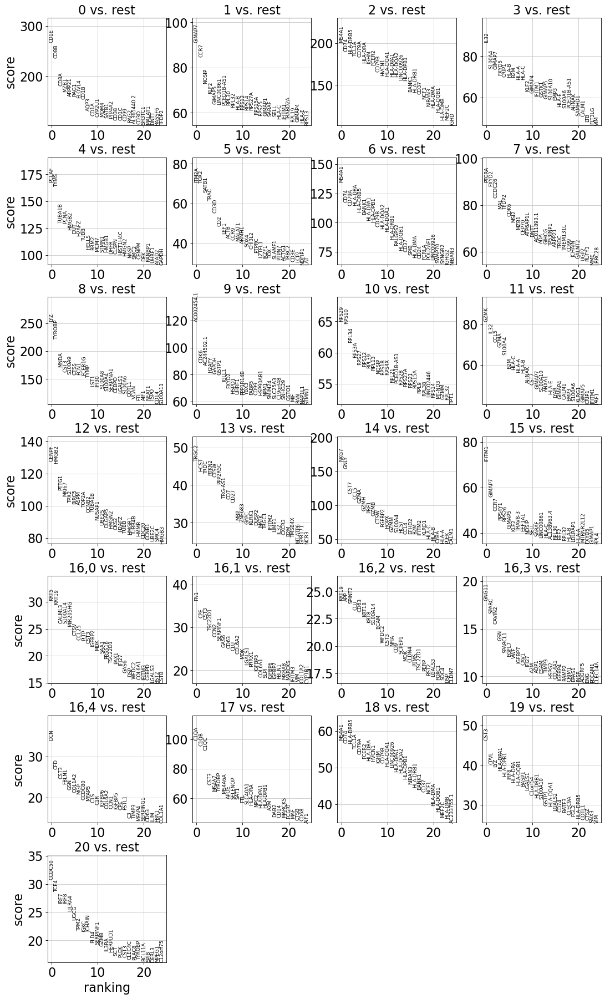

In [34]:
sc.tl.rank_genes_groups(adata, 'leiden_R', method='t-test_overestim_var')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [35]:
print('\n'.join(list(adata.uns['rank_genes_groups']['names']['19'])[:55]))

CST3
CPVL
LYZ
HLA-DPA1
HLA-DPB1
IRF8
HLA-DRA
HLA-DQB1
BASP1
LGALS1
C1orf54
HLA-DRB1
S100A10
GSTP1
HLA-DQA1
LGALS2
CD74
BATF3
CLEC9A
FGL2
HLA-DRB5
COTL1
CTSZ
SNX3
VIM
IDO1
RAB32
SHTN1
HLA-DQA2
SPI1
AC020656.1
PPT1
HLA-DMA
DNASE1L3
WDFY4
ANXA2
LMNA
PLEK
ACTB
GRN
TMSB4X
PTPRE
NDRG2
ALDH2
S100B
C1orf162
TSPAN33
CADM1
C20orf27
SAT1
NME2
DPYSL2
CPNE3
ID2
PTMS


In [36]:
df_clusters =  pd.read_csv('210430_clusters/major_clusters.csv', index_col=0)
df_clusters.index = df_clusters.index.astype(str)
df_clusters

,cluster
leiden,
0,DP T cell
1,T cell
2,B cell
3,T cell
4,Cycling DN/DP T cell
5,T cell
6,B cell
7,DP T cell
8,Myeloid cell


In [37]:
adata.obs['major_cluster'] = [df_clusters.loc[x, 'cluster'] for x in adata.obs['leiden']]

... storing 'major_cluster' as categorical


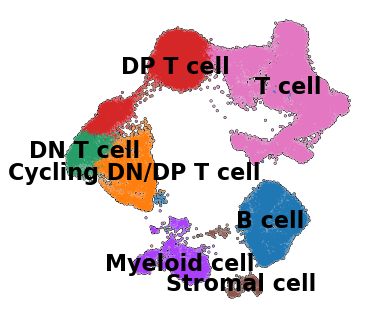

In [38]:
from matplotlib import rcParams

rcParams['figure.figsize'] = 5, 5
sc.pl.umap(adata, color='major_cluster', legend_loc='on data', add_outline=True,
           title='', frameon=False, save='major_cluster.pdf', s=10)

sc.settings.set_figure_params(dpi=80, color_map='viridis', transparent=False, 
                              frameon=False, fontsize=20)  

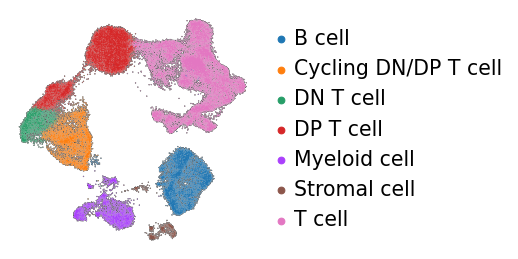

In [39]:
sc.pl.umap(adata, color='major_cluster', title='', add_outline=True, 
           frameon=False, save='cluster_out.pdf')

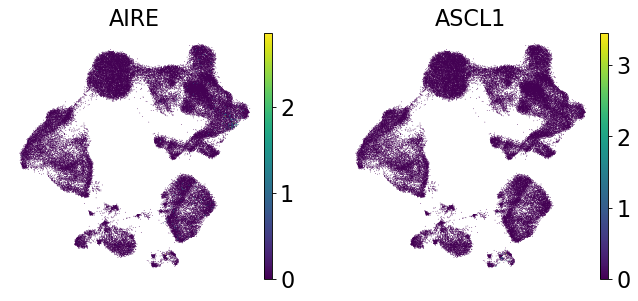

In [40]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['AIRE', 'ASCL1'],
          save=False, ncols=5)

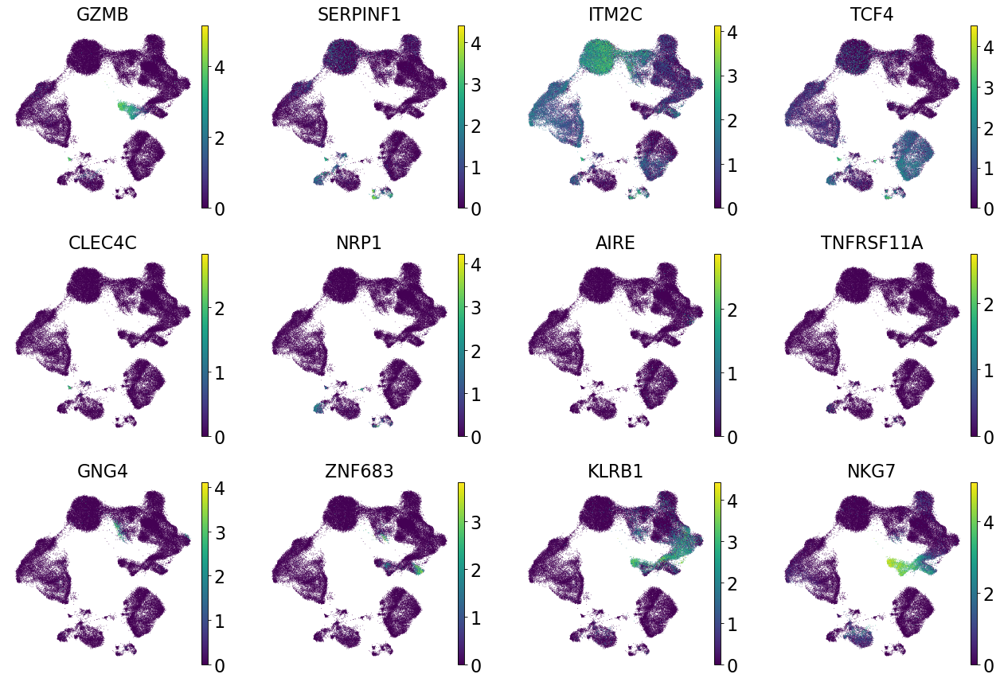

In [41]:
sc.pl.umap(adata, color=['GZMB', 'SERPINF1', 'ITM2C', 'TCF4', 'CLEC4C', 'NRP1', 'AIRE', 'TNFRSF11A',
                         'GNG4', 'ZNF683', 'KLRB1', 'NKG7'], save=False)

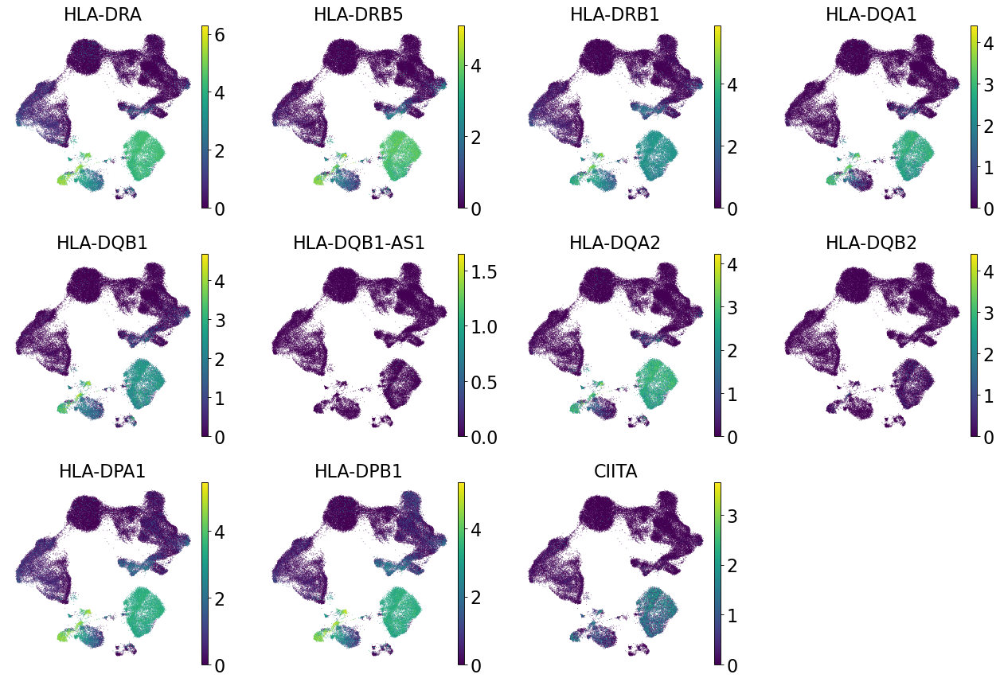

In [42]:
sc.pl.umap(adata, color=[x for x in adata.raw.var.index if ('HLA-DP' in x) or ('HLA-DQ' in x) or ('HLA-DR' in x)] + ['CIITA'], save=False)

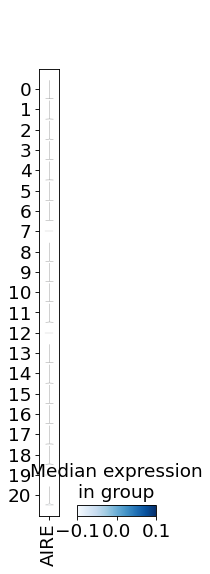

In [43]:
sc.pl.stacked_violin(adata, ['AIRE'], groupby='leiden', rotation=90)

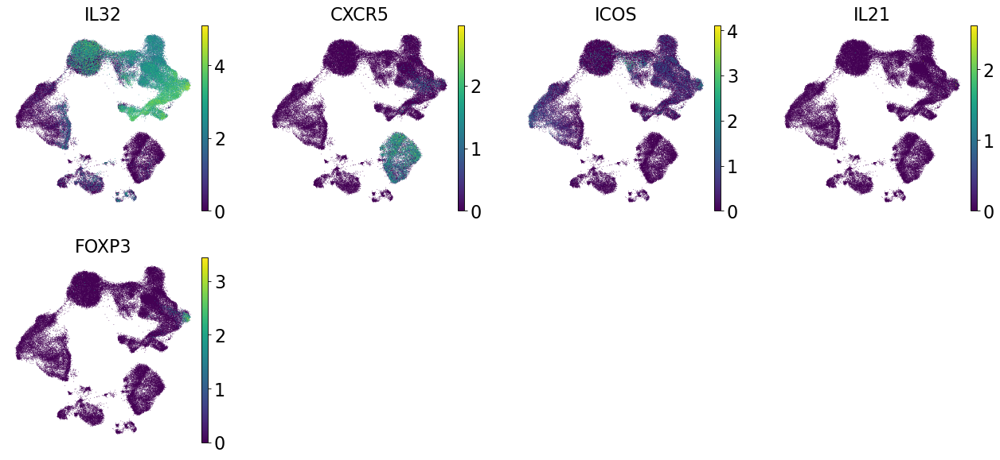

In [44]:
sc.pl.umap(adata, color=['IL32', 'CXCR5', 'ICOS', 'IL21', 'FOXP3'], save=False)

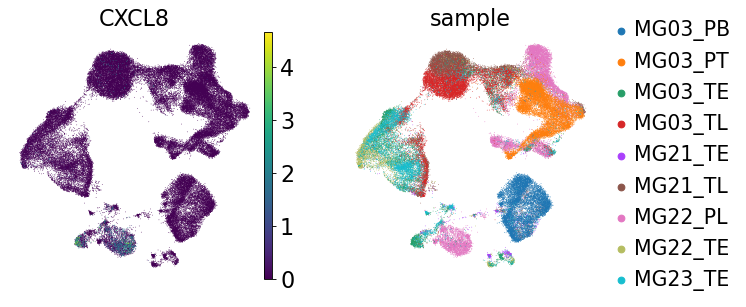

In [45]:
sc.pl.umap(adata, color=['CXCL8', 'sample'], save='IL8.pdf')

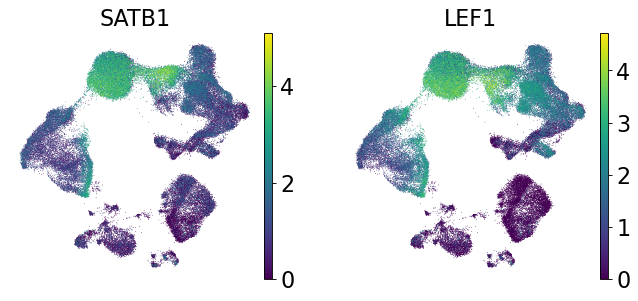

In [46]:
sc.pl.umap(adata, color=['SATB1', 'LEF1'], save=False)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_R']`


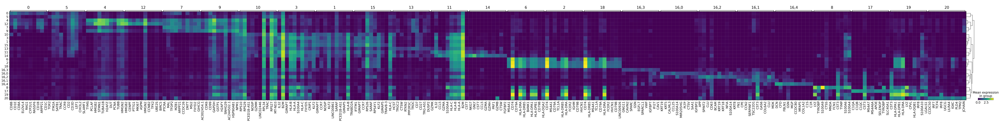

In [313]:
sc.pl.rank_genes_groups_matrixplot(adata, n_genes=10)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


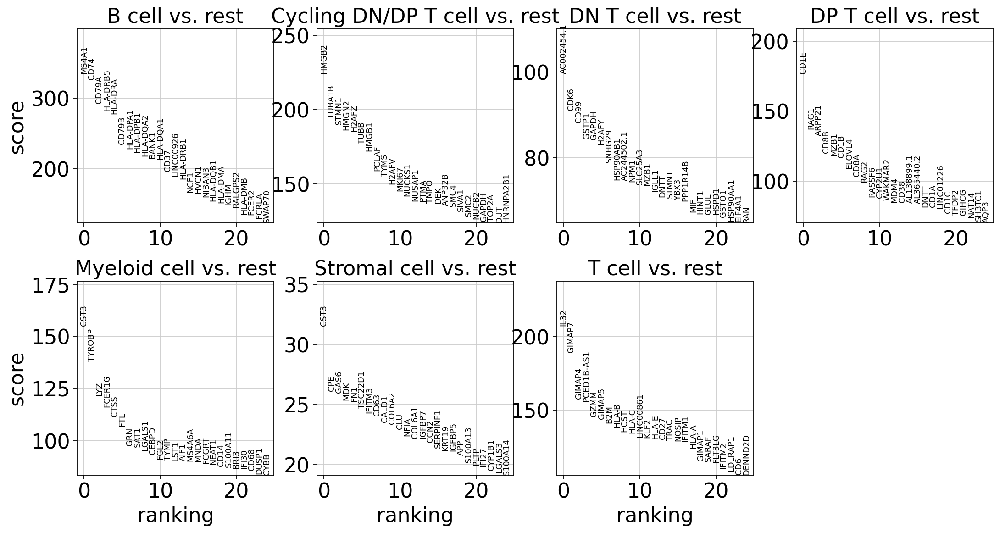

In [72]:
sc.tl.rank_genes_groups(adata, 'major_cluster', method='t-test_overestim_var')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

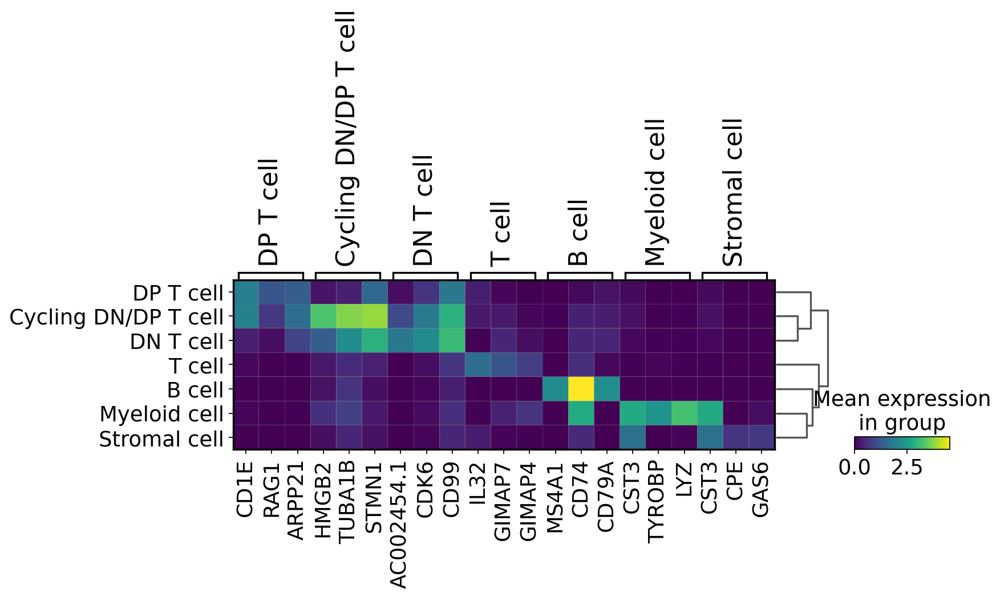

In [73]:
sc.pl.rank_genes_groups_matrixplot(adata, n_genes=3, groupby='major_cluster', save='major_cluster.pdf')

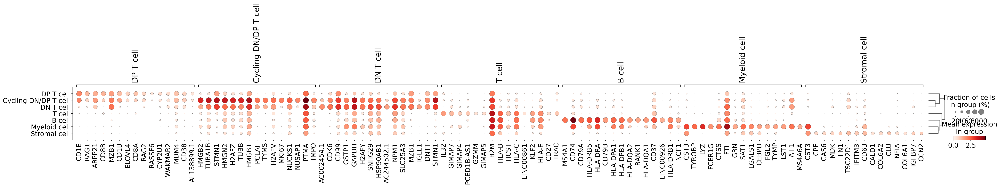

In [74]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=15, groupby='major_cluster', save='major_cluster.pdf')

In [75]:
df_TCGA = pd.read_csv('data/MG.TP.DEG.glmLRT.csv')
df_TCGA.head()

,Unnamed: 0,mRNA,logFC,FDR,NonMG,MG,Delta,entrezgene,external_gene_name
0,ENSG00000115414,ENSG00000115414,-0.945527,0.086154,97928.256098,50849.500000,92593.843704,2335.0,FN1
1,ENSG00000100979,ENSG00000100979,-0.483926,0.201368,149137.365854,106636.441176,72171.444468,5360.0,PLTP
2,ENSG00000142192,ENSG00000142192,-0.902000,0.008180,78341.512195,41924.352941,70664.005270,351.0,APP
3,ENSG00000187244,ENSG00000187244,-1.927363,0.000173,35640.512195,9370.294118,68692.196536,4059.0,BCAM
4,ENSG00000137818,ENSG00000137818,0.322183,0.055696,155695.853659,194653.205882,50162.595218,6176.0,RPLP1


In [318]:
!pwd

/mnt/media32TB/home/yyasumizu/bioinformatics/MG_scRNAseq


In [49]:
adata.write(results_file)

## Resume

Run and define clusters.

210430_thymoma_MG21.22.23.03_Bcell.ipynb
210430_thymoma_MG21.22.23.03_Myeloid.ipynb
210430_thymoma_MG21.22.23.03_TEC.ipynb
210430_thymoma_MG21.22.23.03_Tcell.ipynb
210430_thymoma_MG21.22.23.03_Tcell_CD4.ipynb

In [4]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis', transparent=False, frameon=False,
                             fontsize=20)  # low dpi (dots per inch) yields small inline figures

import matplotlib as mpl
# 2 lines below solved the facecolor problem.
# mpl.rcParams['figure.facecolor'] = 'white'
mpl.rcParams['figure.facecolor'] = (1,1,1,1)
sc.settings.autosave = True
sc.logging.print_versions()

version = '210711_merged_thymoma_MG21.22.23.03'

# file_mat = 'F1314_200323_222536_summary/10425963-2_3DE_genematrix.csv'

results_file = './scanpy/{}/merge.h5ad'.format(version)
results_raw_file = './scanpy/{}/merge.raw.h5ad'.format(version)

# minor clusters
results_file_tcell = './scanpy/{}_Tcell/merge_Tcell_minor_cluster.h5ad'.format(version)
results_file_bcell = './scanpy/{}_Bcell/merge_Bcell_minor_cluster.h5ad'.format(version)
results_file_myeloid = './scanpy/{}_myeloid/merge_myeloid_minor_cluster.h5ad'.format(version)
results_file_stroma = './scanpy/{}_TEC/merge_stroma_minor_cluster.h5ad'.format(version)

# minor cluster
results_file_minor_cluster = './scanpy/{}/merge.minor_cluster.h5ad'.format(version)
results_file_cg_minor_cluster = './scanpy/{}/merge_cg.minor_cluster.h5ad'.format(version)

# for cellphonedb
raw_matrix = './scanpy/{}/merge.raw.tsv'.format(version)

sc.settings.figdir = './scanpy/{}/graph'.format(version)
sc.settings.cachedir = './scanpy/{}/cache'.format(version)
# %config InlineBackend.figure_format = 'retina'

-----
anndata     0.7.6
scanpy      1.7.2
sinfo       0.3.1
-----
PIL                 8.1.2
anndata             0.7.6
attr                20.3.0
backcall            0.2.0
cffi                1.14.5
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.1
decorator           4.4.2
get_version         2.1
google              NA
h5py                2.10.0
idna                2.10
igraph              0.9.1
ipykernel           5.3.4
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.17.2
jinja2              2.11.3
joblib              1.0.1
jsonschema          3.2.0
kiwisolver          1.3.1
legacy_api_wrap     1.2
leidenalg           0.8.4
llvmlite            0.34.0
markupsafe          1.1.1
matplotlib          3.4.1
mpl_toolkits        NA
natsort             7.1.1
nbformat            5.1.3
numba               0.51.0
numexpr             2.7.3
numpy               1.20.2
packaging           20.9
pandas              1.2.4
pars

In [51]:
adata = sc.read(results_file)
adata_tcell = sc.read(results_file_tcell)
adata_bcell = sc.read(results_file_bcell)
adata_myeloid = sc.read(results_file_myeloid)
adata_stroma = sc.read(results_file_stroma)

In [52]:
df_minor_cluster = pd.concat([adata_tcell.obs[['minor_cluster']],
          adata_bcell.obs[['minor_cluster']],
          adata_myeloid.obs[['minor_cluster']],
          adata_stroma.obs[['minor_cluster']]])
df_minor_cluster.head()

,minor_cluster
AACCATGGTCTCAGAT,Naive Treg
AACGTCAGTACATTGC,Thymic CD8 T cell
AAGAACAAGCGGCTCT,Thymic CD4 T cell (II)
AAGCATCCATGACGTT,CD4 Tcm (Th17)
AAGCGAGCAGACAAAT,CD4 Tnaive


In [53]:
adata.obs['minor_cluster'] = df_minor_cluster.reindex(adata.obs.index)['minor_cluster']
adata.obs.loc[adata.obs['minor_cluster'].isna(), 'minor_cluster'] = \
    adata.obs.loc[adata.obs['minor_cluster'].isna(), 'major_cluster'] 

In [54]:
adata.obs['minor_cluster'].unique()

array(['Cycling DN/DP T cell', 'DP T cell', 'DN T cell', 'mTEC (I)',
       'Doublet', 'Unswitched memory B cell', 'Naive B cell',
       'Endothelial cell', 'Monocyte (CD14)', 'Naive Treg',
       'Thymic memory B cell', 'Thymic CD8 T cell',
       'Thymic CD4 T cell (II)', 'Plasmablast', 'Memory B cell (I)',
       'CD4 Tcm (Th17)', 'CD4 Tnaive', 'aa CD8 T cell (I)', 'cDC1',
       'Tumor associated fibroblast', 'gd T cell',
       'Thymic CD4 T cell (I)', 'nmTEC', 'mTEC (II)', 'GC B cell',
       'Macrophage', 'CD8 Trm', 'cDC2', 'ILC', 'pDC', 'CD8 Tem',
       'Pre GC B cell', 'CD4 Tcm (Tfh)', 'aa CD8 T cell (II)', 'NK cell',
       'Normal fibroblast', 'Memory B cell (II)', 'CD4 Tcm (Th0)',
       'NKT cell (periphery)', 'CD8 Tnaive', 'NKT cell (thymus)',
       'CD8 Temra', 'T agonist', 'Stromal cell', 'CD4 Tcm (Th2)',
       'CD4 Tem (Th1)', 'CD4 Tem (Th1/17)', 'Activated Treg', 'cTEC',
       'Monocyte (CD16)', 'CD4 Temra (Th1)', 'B cell', 'Myeloid cell'],
      dtype=object)

In [55]:
list_exclude_clusters = ['T cell', 'B cell', 'Myeloid cell', 'Stromal cell', 'Doublet']
adata = adata[~adata.obs['minor_cluster'].isin(list_exclude_clusters)]

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'minor_cluster' as categorical


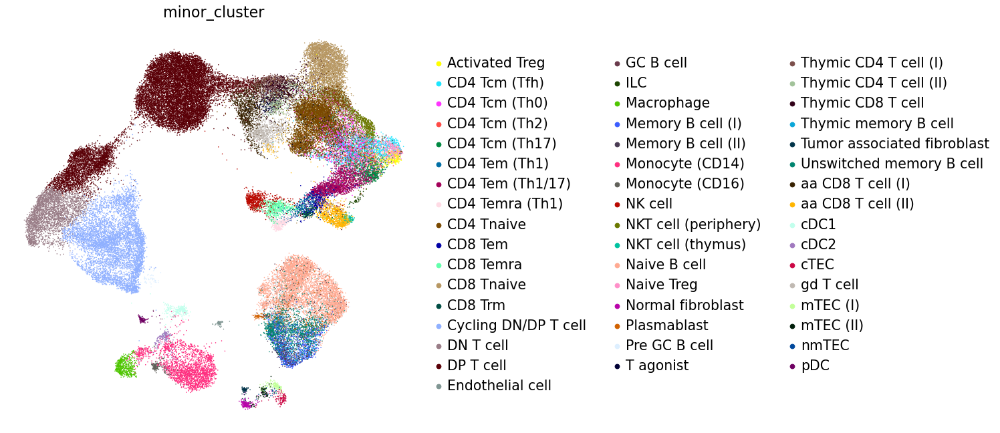

In [56]:
with plt.rc_context({"figure.figsize": (10,10)}):
    sc.pl.umap(adata, color='minor_cluster', save='minor_cluster', s=8)

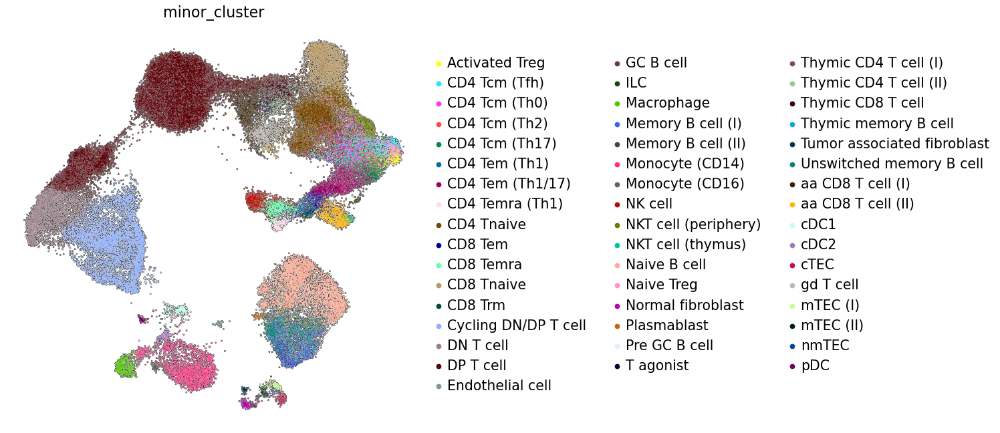

In [57]:
with plt.rc_context({"figure.figsize": (10,10)}):
    sc.pl.umap(adata, color='minor_cluster', save='minor_cluster_out', s=8, add_outline=True)

In [83]:
cell_cycle_genes = [x.strip() for x in open('./data/regev_lab_cell_cycle_genes.txt')]

In [84]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

In [85]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    127 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    289 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


... storing 'phase' as categorical


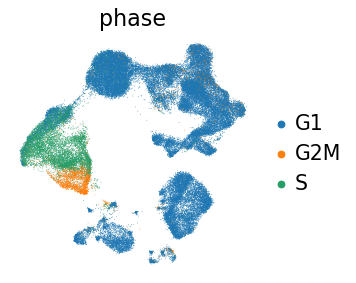

In [86]:
sc.pl.umap(adata, color=['phase'], save='cell_cycle', ncols=5)

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/seaborn/matrix.py:1205: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(**tight_params)


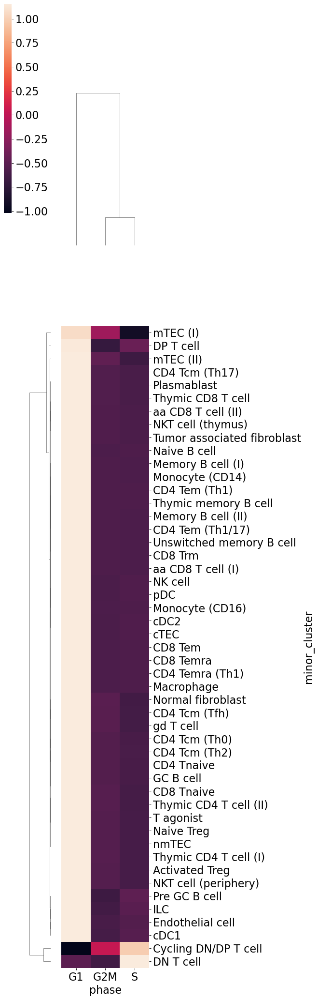

In [92]:
sns.clustermap(pd.crosstab(adata.obs['minor_cluster'], adata.obs['phase']), z_score=0, figsize=(4,30))

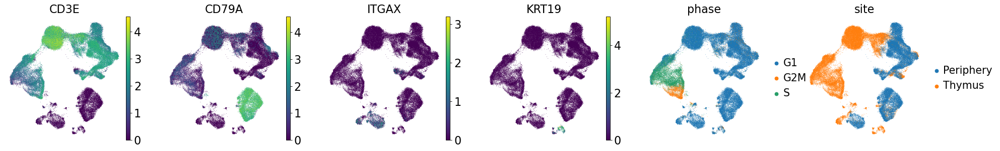

In [94]:
sc.pl.umap(adata, color=['CD3E', 'CD79A', 'ITGAX', 'KRT19', 'phase', 'site'], save='fig2_panel', ncols=6)

In [59]:
list_ab = list(pd.read_csv('../TCGA_thymoma/autoantibodies_targets_thymoma.txt', header=None)[0])
res = pd.read_csv('../TCGA_thymoma/210513_DSeq2WGCNA/DESeq2.res.all.csv', index_col=0)
res = res.reindex(list_ab).dropna()
list_ab = list(res[res['log2FoldChange'] > 0].index)
sc.tl.score_genes(adata, list_ab, score_name='score_autoantibodies', use_raw=True)

computing score 'score_autoantibodies'
    finished: added
    'score_autoantibodies', score of gene set (adata.obs).
    700 total control genes are used. (0:00:07)


In [60]:
list_gwas = list(pd.read_csv('./data/GWAS_LOMG_MG.txt', header=None)[0])
list_gwas = [x for x in list_gwas if x in adata.raw.var.index]
sc.tl.score_genes(adata, list_gwas, score_name='score_GWAS', use_raw=True)

computing score 'score_GWAS'
    finished: added
    'score_GWAS', score of gene set (adata.obs).
    400 total control genes are used. (0:00:17)


In [9]:
adata = sc.read(results_file_minor_cluster)

In [17]:
df_lde = pd.read_csv('data/LDexpress/express_variants_annotated_MG_GWAS.txt', sep='\t')
df_lde.head()

,Query,RS ID,Position,R2,D',Gene Symbol,Gencode ID,Tissue,Non-effect Allele Freq,Effect Allele Freq,Effect Size,P-value
0,rs6998967,rs113730366,chr8:81349061,0.610976,0.881090,RP11-48B3.5,ENSG00000251867.3,Thyroid,C=0.811,T=0.189,-0.182605,0.000130
1,rs6998967,rs16907718,chr8:81355863,0.256973,0.635513,RP11-48B3.5,ENSG00000251867.3,Thyroid,C=0.682,T=0.318,-0.155615,0.000111
2,rs6998967,rs365903,chr8:81357631,0.208711,0.625408,RP11-48B3.5,ENSG00000251867.3,Thyroid,T=0.642,A=0.358,-0.154831,0.000123
3,rs6998967,rs4610800,chr8:81358791,0.262759,0.645882,RP11-48B3.5,ENSG00000251867.3,Thyroid,C=0.68,A=0.32,-0.158668,0.000080
4,rs6998967,rs10095089,chr8:81359895,0.225103,0.632378,RP11-48B3.5,ENSG00000251867.3,Thyroid,G=0.655,T=0.345,-0.156200,0.000096


In [18]:
df_lde.groupby(by='Query')

In [37]:
ddf = df_lde.groupby('Query')
df_lde_lead = df_lde.loc[ddf['P-value'].idxmin(),:]
list_gwas_ld = [x for x in df_lde_lead['Gene Symbol'] if x in adata.raw.var.index]
sc.tl.score_genes(adata, list_gwas_ld, score_name='score_GWAS_LD', use_raw=True)
df_lde_lead

computing score 'score_GWAS_LD'
    finished: added
    'score_GWAS_LD', score of gene set (adata.obs).
    350 total control genes are used. (0:00:02)


,Query,RS ID,Position,R2,D',Gene Symbol,Gencode ID,Tissue,Non-effect Allele Freq,Effect Allele Freq,Effect Size,P-value
4284,rs12653117,rs701497,chr5:9380798,0.148676,1.000000,SNHG18,ENSG00000250786.1,Nerve - Tibial,T=0.655,G=0.345,-0.208738,1.087340e-05
4605,rs2233290,rs2233290,chr5:150436503,1.000000,1.000000,TNIP1,ENSG00000145901.14,Cells - Cultured fibroblasts,G=0.905,C=0.095,0.235822,1.265840e-07
4508,rs231770,rs11571302,chr2:204742934,0.449819,0.885037,CTLA4,ENSG00000163599.14,Testis,G=0.571,T=0.429,0.422179,2.113330e-15
4401,rs2476601,rs1230666,chr1:114173410,0.564812,0.916351,PHTF1,ENSG00000116793.15,Cells - Cultured fibroblasts,A=0.04,G=0.96,0.325616,4.508010e-09
4379,rs4128527,rs4503141,chr8:72675903,0.305340,0.865531,RP11-1144P22.1,ENSG00000254277.1,Pituitary,A=0.42,G=0.58,0.332863,5.317500e-07
4544,rs4263037,rs4500848,chr18:60014463,0.196334,0.965359,KIAA1468,ENSG00000134444.13,Nerve - Tibial,T=0.126,C=0.874,-0.328002,5.614380e-11
4386,rs4518467,rs9362886,chr6:92256671,0.334997,0.631981,RPL5P19,ENSG00000220553.1,Heart - Atrial Appendage,G=0.906,C=0.094,0.429037,2.723270e-05
24,rs4574025,rs77566182,chr18:60022473,0.126733,0.670794,PIGN,ENSG00000197563.10,Brain - Caudate (basal ganglia),A=0.719,G=0.281,-0.322164,1.465430e-05
4288,rs6914704,rs12206258,chr6:1709703,0.100638,0.502923,FOXC1,ENSG00000054598.6,Whole Blood,T=0.751,C=0.249,-0.312052,4.990780e-25
5,rs6998967,rs189201451,chr8:81361699,0.124776,1.000000,TPD52,ENSG00000076554.15,Muscle - Skeletal,C=0.964,T=0.036,0.363798,9.047110e-06


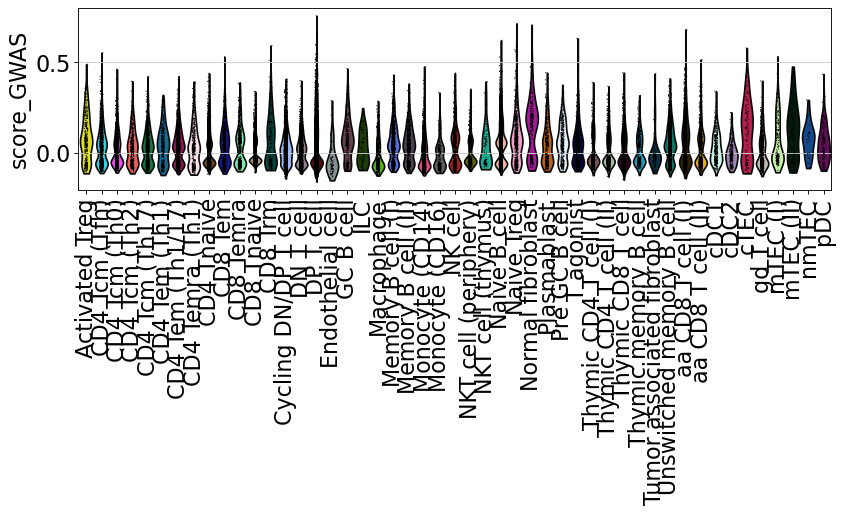

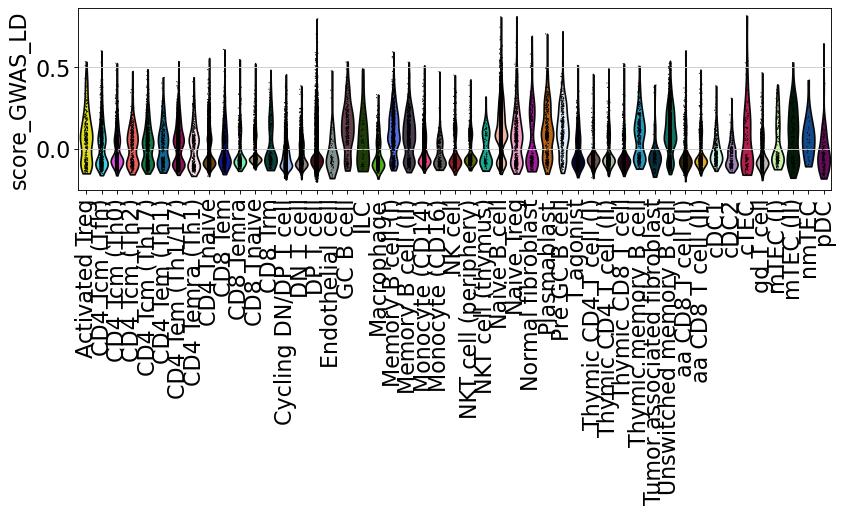

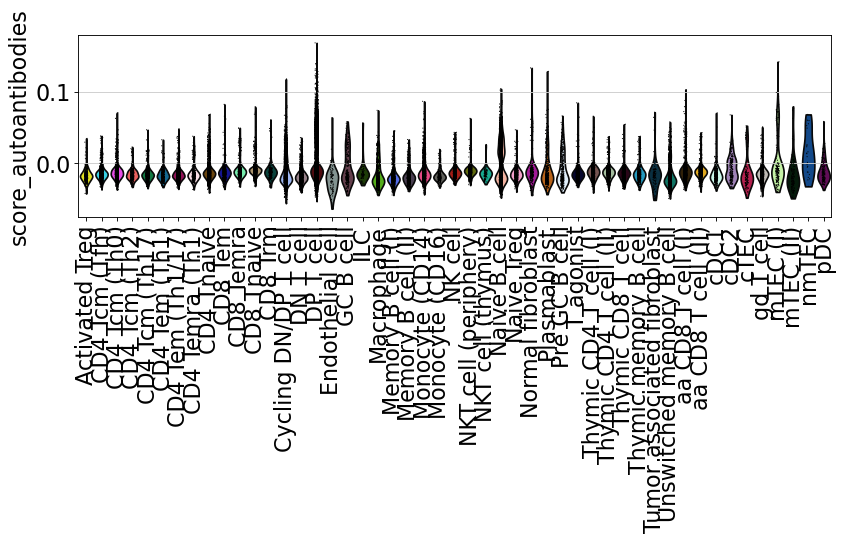

In [36]:
for c in ['score_GWAS', 'score_GWAS_LD', 'score_autoantibodies']:
    with plt.rc_context({"figure.figsize": (10,3)}):
        sc.pl.violin(adata, c, groupby='minor_cluster', log=False, rotation=90, save='minor_cluster_{}.pdf'.format(c))

In [22]:
adata.obs.groupby(by='minor_cluster').mean()['score_autoantibodies']

minor_cluster
Activated Treg                -0.016656
CD4 Tcm (Tfh)                 -0.013968
CD4 Tcm (Th0)                 -0.012098
CD4 Tcm (Th2)                 -0.015313
CD4 Tcm (Th17)                -0.015482
CD4 Tem (Th1)                 -0.015605
CD4 Tem (Th1/17)              -0.015815
CD4 Temra (Th1)               -0.014022
CD4 Tnaive                    -0.013325
CD8 Tem                       -0.012607
CD8 Temra                     -0.009884
CD8 Tnaive                    -0.009779
CD8 Trm                       -0.011499
Cycling DN/DP T cell          -0.013498
DN T cell                     -0.018760
DP T cell                      0.000482
Endothelial cell              -0.023746
GC B cell                     -0.004070
ILC                           -0.014010
Macrophage                    -0.015047
Memory B cell (I)             -0.019493
Memory B cell (II)            -0.017714
Monocyte (CD14)               -0.012186
Monocyte (CD16)               -0.016636
NK cell                   

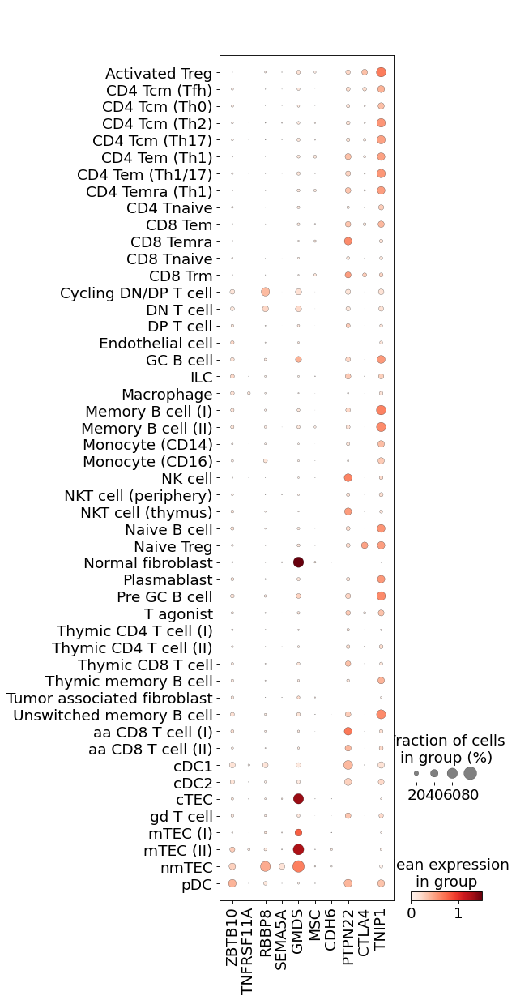

In [64]:
sc.pl.dotplot(adata, list_gwas, groupby='minor_cluster', save='gwas.pdf')

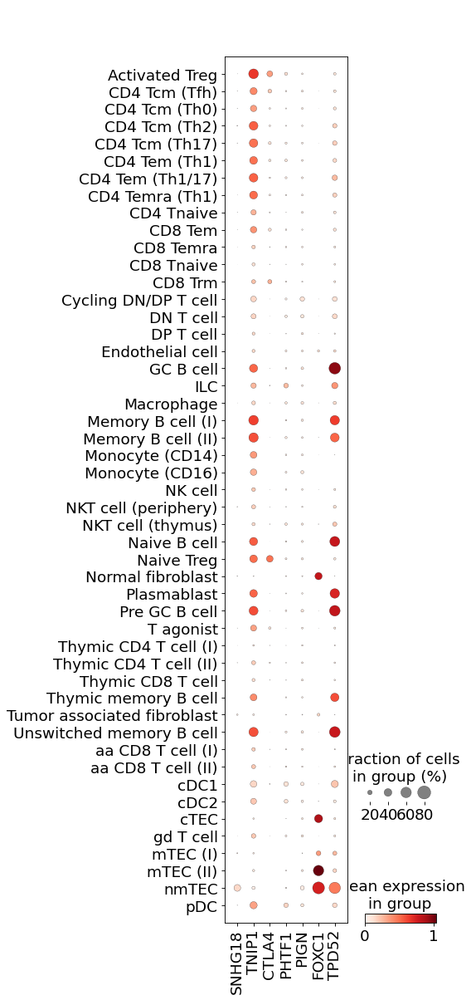

In [38]:
sc.pl.dotplot(adata, list_gwas_ld, groupby='minor_cluster', save='GWAS_ldexpression')

In [65]:
[x for x in adata.raw.var.index if 'HLA' in x]

['HHLA3',
 'SCHLAP1',
 'HHLA2',
 'HLA-F',
 'HLA-F-AS1',
 'HLA-G',
 'HLA-A',
 'HLA-E',
 'HLA-C',
 'HLA-B',
 'HLA-DRA',
 'HLA-DRB5',
 'HLA-DRB1',
 'HLA-DQA1',
 'HLA-DQB1',
 'HLA-DQB1-AS1',
 'HLA-DQA2',
 'HLA-DQB2',
 'HLA-DOB',
 'HLA-DMB',
 'HLA-DMA',
 'HLA-DOA',
 'HLA-DPA1',
 'HLA-DPB1',
 'HHLA1']

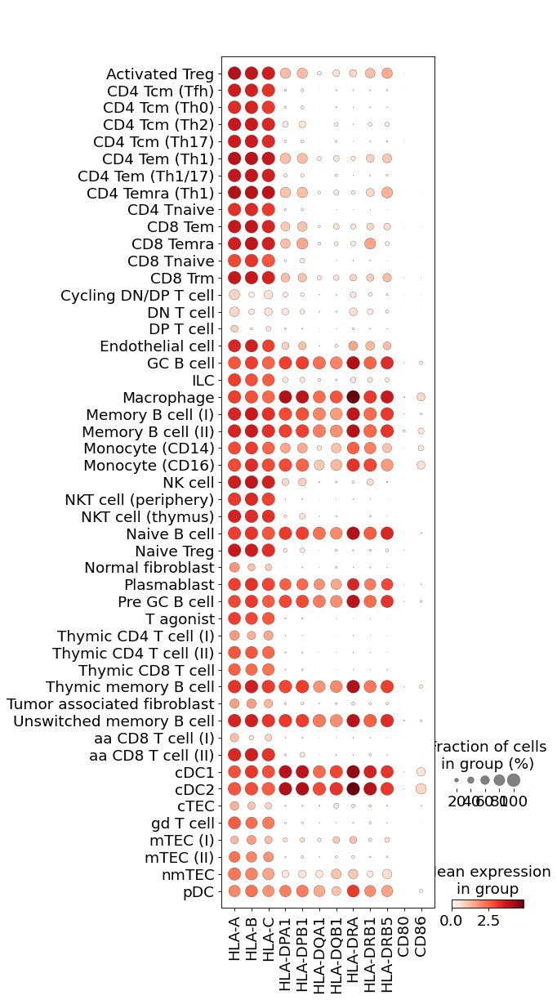

In [27]:
list_hla = ['HLA-A', 'HLA-B', 'HLA-C', 'HLA-DPA1', 'HLA-DPB1', 
'HLA-DQA1', 'HLA-DQB1', 'HLA-DRA', 'HLA-DRB1', 'HLA-DRB5', 'CD80', 'CD86']

sc.pl.dotplot(adata, list_hla, groupby='minor_cluster', save='majorHLA.pdf')

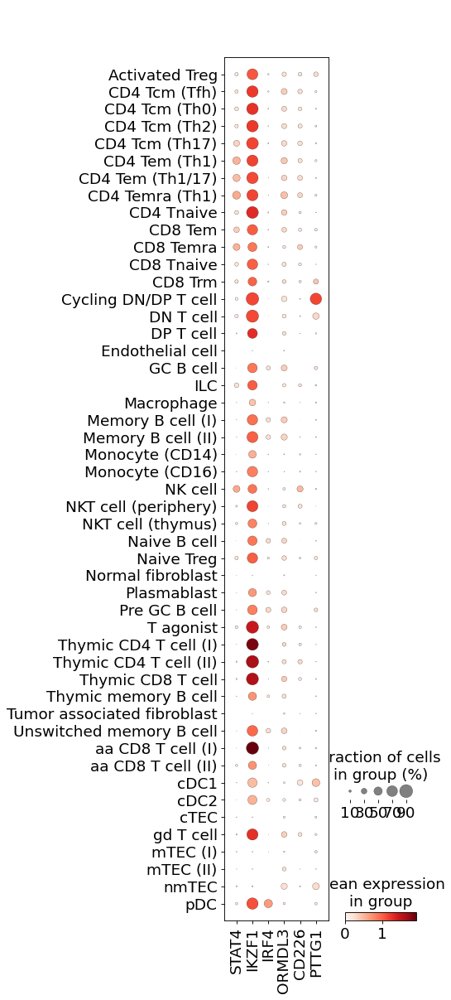

In [67]:
sc.pl.dotplot(adata, ['STAT4', 'IKZF1', 'IRF4', 'ORMDL3', 'CD226', 'PTTG1'], groupby='minor_cluster')

In [25]:
list_colors = ['black', 'turquoise', 'blue', 'yellow', 'green', 'red', 'grey']
list_gene_colors = []
for c in list_colors:
    d = pd.read_csv('../TCGA_thymoma/200703_DSeq2WGCNA/{}.txt'.format(c), header=None)
    list_gene_colors.append(list(d[0]))

In [69]:
for c,g in zip(list_colors, list_gene_colors):
    sc.tl.score_genes(adata, g, score_name='score_{}'.format(c), use_raw=True)

computing score 'score_black'
    finished: added
    'score_black', score of gene set (adata.obs).
    896 total control genes are used. (0:00:14)
computing score 'score_turquoise'
    finished: added
    'score_turquoise', score of gene set (adata.obs).
    1021 total control genes are used. (0:00:12)
computing score 'score_blue'
    finished: added
    'score_blue', score of gene set (adata.obs).
    1021 total control genes are used. (0:00:12)
computing score 'score_yellow'
    finished: added
    'score_yellow', score of gene set (adata.obs).
    894 total control genes are used. (0:00:12)
computing score 'score_green'
    finished: added
    'score_green', score of gene set (adata.obs).
    893 total control genes are used. (0:00:13)
computing score 'score_red'
    finished: added
    'score_red', score of gene set (adata.obs).
    747 total control genes are used. (0:00:12)
computing score 'score_grey'
    finished: added
    'score_grey', score of gene set (adata.obs).
    750 

In [70]:
['score_{}'.format(c) for c in list_colors]

['score_black',
 'score_turquoise',
 'score_blue',
 'score_yellow',
 'score_green',
 'score_red',
 'score_grey']

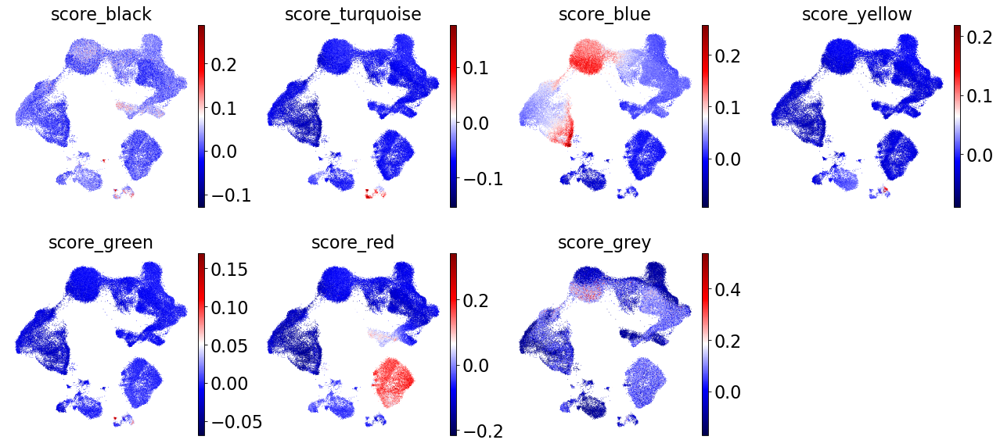

In [71]:
sc.pl.umap(adata, color=['score_{}'.format(c) for c in list_colors], cmap='seismic')

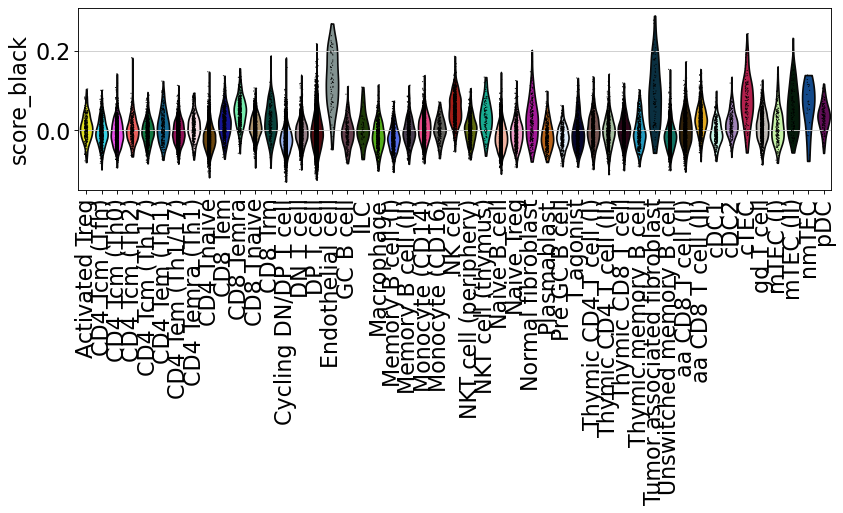

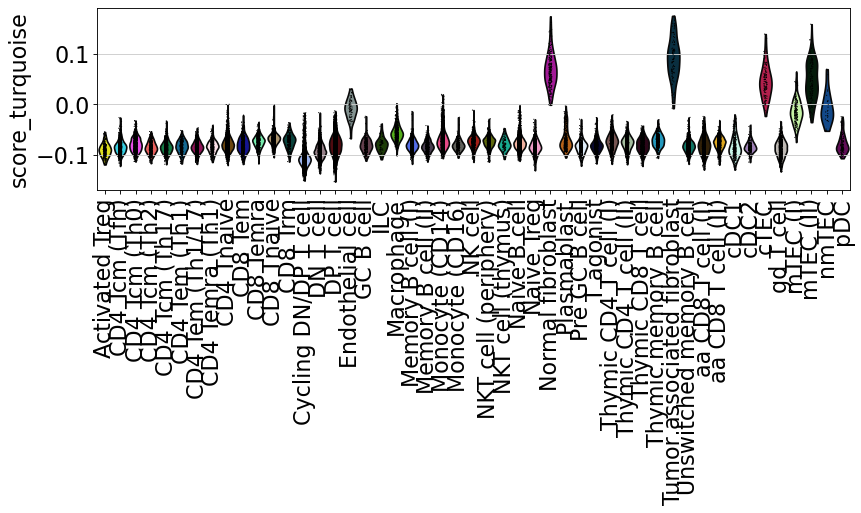

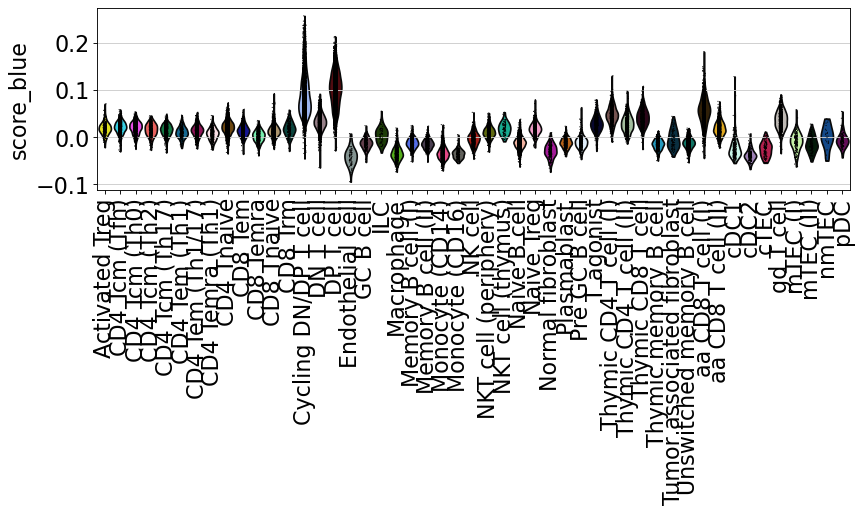

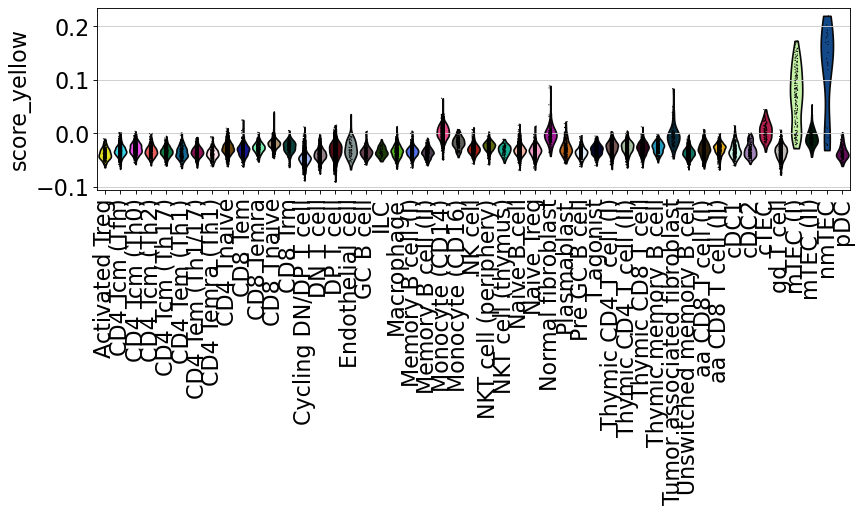

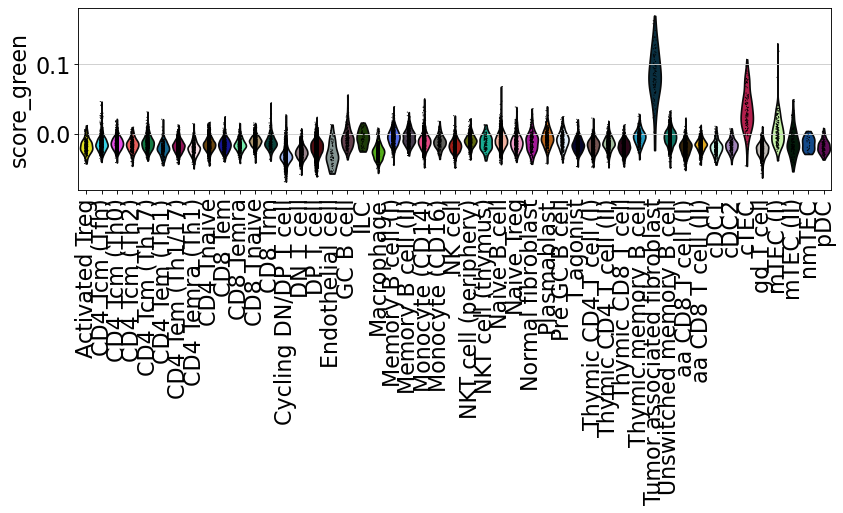

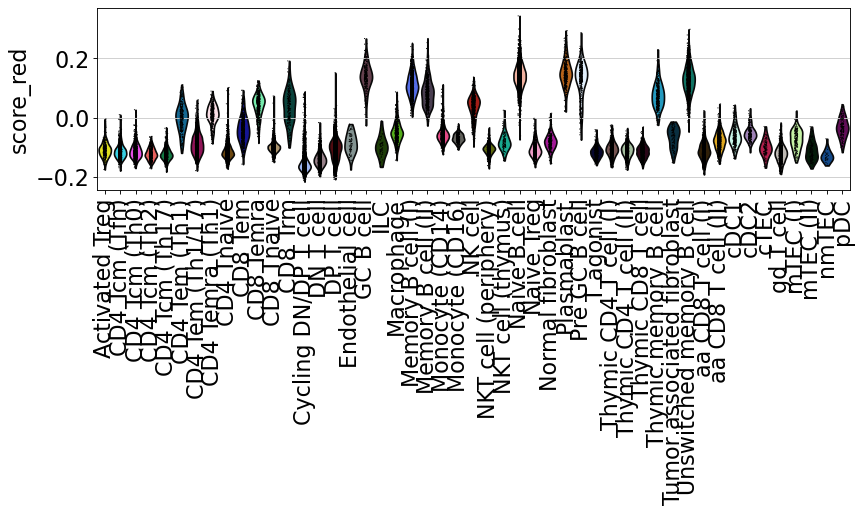

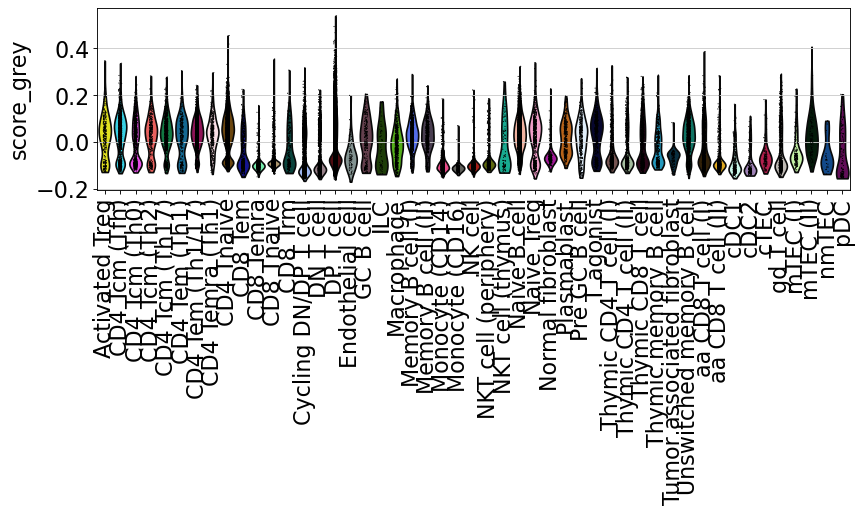

In [72]:
with plt.rc_context({"figure.figsize": (10, 3)}):
    for c in list_colors:
        sc.pl.violin(adata, ['score_{}'.format(c)], groupby='minor_cluster', log=False,
             rotation=90, save='minor_module{}.pdf'.format(c))

In [27]:
list_idx = list(adata.obs['minor_cluster'].cat.categories)

In [39]:
list_stats = []
list_col = []

for c in list_colors + ['autoantibodies', 'GWAS', 'GWAS_LD']:
    list_stats.append(list(adata.obs[['score_{}'.format(c), 'minor_cluster']]\
                           .groupby(by='minor_cluster').mean().loc[list_idx, 'score_{}'.format(c)]))
    
    l_p = []
    for cl in list_idx:
        st, p = stats.mannwhitneyu(adata.obs.loc[adata.obs['minor_cluster'] == cl, 'score_{}'.format(c)], 
                       adata.obs.loc[adata.obs['minor_cluster'] != cl, 'score_{}'.format(c)], 
                       alternative='two-sided')
        l_p.append(p)
    list_stats.append(l_p)
    list_stats.append(multi.multipletests(l_p)[1])
    
    list_col += ['mean_{}'.format(c), 'pval_{}'.format(c), 'padj_{}'.format(c)]
    
df_stats = pd.DataFrame(list_stats, columns=list_idx, index=list_col).T
df_stats

,mean_black,pval_black,padj_black,mean_turquoise,pval_turquoise,padj_turquoise,mean_blue,pval_blue,padj_blue,mean_yellow,...,padj_grey,mean_autoantibodies,pval_autoantibodies,padj_autoantibodies,mean_GWAS,pval_GWAS,padj_GWAS,mean_GWAS_LD,pval_GWAS_LD,padj_GWAS_LD
Activated Treg,0.006020,2.491932e-08,5.731442e-07,-0.090567,8.311538e-20,0.000000e+00,0.018707,1.387080e-06,8.322451e-06,-0.037757,...,9.276291e-10,-0.016656,7.824945e-13,2.660450e-11,0.081053,2.492710e-16,8.659740e-15,0.071420,3.204396e-15,9.980905e-14
CD4 Tcm (Tfh),-0.003883,1.650962e-01,7.172159e-01,-0.084588,3.030660e-11,6.667462e-10,0.021402,4.527471e-10,4.074724e-09,-0.032146,...,0.000000e+00,-0.013968,2.332423e-09,6.997268e-08,0.037162,3.958936e-07,1.029318e-05,0.024770,6.876489e-09,1.856652e-07
CD4 Tcm (Th0),-0.004262,3.486526e-01,9.236382e-01,-0.079973,2.480166e-04,4.207927e-03,0.020303,6.921507e-15,8.260059e-14,-0.028287,...,2.451372e-13,-0.012098,9.301846e-01,9.778451e-01,0.018017,5.589674e-01,9.621659e-01,0.004016,5.442706e-05,1.142346e-03
CD4 Tcm (Th2),0.001481,3.017255e-04,4.516336e-03,-0.085607,2.302995e-06,4.605889e-05,0.016013,8.812408e-12,9.693635e-11,-0.033180,...,3.834710e-13,-0.015313,1.376128e-07,3.440313e-06,0.032005,3.375778e-02,3.377345e-01,0.025118,5.251688e-06,1.260329e-04
CD4 Tcm (Th17),-0.003376,2.881175e-02,2.958891e-01,-0.085327,3.441581e-12,7.915635e-11,0.015401,5.878336e-28,0.000000e+00,-0.033770,...,0.000000e+00,-0.015482,1.698736e-19,0.000000e+00,0.030471,1.034363e-03,1.743941e-02,0.031697,9.128395e-16,2.842171e-14
CD4 Tem (Th1),0.009665,6.673084e-09,1.668271e-07,-0.083635,7.971261e-02,4.409324e-01,0.010156,7.743164e-20,0.000000e+00,-0.035141,...,5.025350e-08,-0.015605,3.966798e-08,1.110703e-06,0.044633,3.172823e-04,6.011181e-03,0.027656,5.929357e-05,1.185204e-03
CD4 Tem (Th1/17),-0.004296,6.344719e-02,4.808143e-01,-0.084909,2.111403e-19,0.000000e+00,0.014411,4.289698e-73,0.000000e+00,-0.034490,...,0.000000e+00,-0.015815,1.411307e-49,0.000000e+00,0.036551,4.273664e-16,1.687539e-14,0.037216,6.049490e-41,0.000000e+00
CD4 Temra (Th1),0.008209,1.275959e-14,3.447242e-13,-0.084133,1.862613e-03,2.938909e-02,0.007221,1.341198e-38,0.000000e+00,-0.037636,...,0.000000e+00,-0.014022,1.274573e-07,3.313883e-06,0.034058,3.237289e-01,9.353087e-01,0.013336,1.785896e-01,6.201526e-01
CD4 Tnaive,-0.019163,1.178580e-231,0.000000e+00,-0.079519,8.666372e-27,0.000000e+00,0.021119,6.025783e-62,0.000000e+00,-0.027716,...,0.000000e+00,-0.013325,2.020057e-14,7.274181e-13,0.004115,8.467144e-32,0.000000e+00,-0.015578,7.774531e-16,2.564615e-14
CD8 Tem,0.017659,5.378396e-39,0.000000e+00,-0.079569,9.378752e-03,1.069173e-01,0.014410,1.307555e-21,0.000000e+00,-0.030538,...,2.062575e-04,-0.012607,6.141955e-01,9.778451e-01,0.041993,1.172926e-06,2.932273e-05,0.012349,5.330357e-03,6.942116e-02


In [30]:
df_stats.to_csv(str(sc.settings.figdir) + '/../minor_cluster_module_stats.csv')

In [43]:
list_stats = []
list_col = []

for c in list_colors + ['autoantibodies', 'GWAS', 'GWAS_LD']:
    list_stats.append(list(adata.obs[['score_{}'.format(c), 'minor_cluster']]\
                           .groupby(by='minor_cluster').mean().loc[list_idx, 'score_{}'.format(c)]))
    
    l_p = []
    for cl in list_idx:
        st, p = stats.ttest_ind(adata.obs.loc[adata.obs['minor_cluster'] == cl, 'score_{}'.format(c)], 
                       adata.obs.loc[adata.obs['minor_cluster'] != cl, 'score_{}'.format(c)], 
                       alternative='two-sided')
        l_p.append(p)
    list_stats.append(l_p)
    list_stats.append(multi.multipletests(l_p)[1])
    
    list_col += ['mean_{}'.format(c), 'pval_{}'.format(c), 'padj_{}'.format(c)]
    
df_stats = pd.DataFrame(list_stats, columns=list_idx, index=list_col).T
df_stats.to_csv(str(sc.settings.figdir) + '/../minor_cluster_module_stats.ttest.csv')
df_stats

,mean_black,pval_black,padj_black,mean_turquoise,pval_turquoise,padj_turquoise,mean_blue,pval_blue,padj_blue,mean_yellow,...,padj_grey,mean_autoantibodies,pval_autoantibodies,padj_autoantibodies,mean_GWAS,pval_GWAS,padj_GWAS,mean_GWAS_LD,pval_GWAS_LD,padj_GWAS_LD
Activated Treg,0.006020,3.667041e-06,7.333827e-05,-0.090567,2.268536e-12,6.351852e-11,0.018707,1.253330e-11,1.253331e-10,-0.037757,...,1.808510e-09,-0.016656,2.135253e-11,7.046317e-10,0.081053,9.880583e-26,0.000000e+00,0.071420,3.698792e-25,0.000000e+00
CD4 Tcm (Tfh),-0.003883,6.604189e-01,9.984098e-01,-0.084588,5.939437e-07,1.366062e-05,0.021402,4.924729e-30,0.000000e+00,-0.032146,...,0.000000e+00,-0.013968,1.843779e-17,0.000000e+00,0.037162,7.290033e-08,2.041207e-06,0.024770,2.547254e-13,6.621814e-12
CD4 Tcm (Th0),-0.004262,9.037535e-01,9.984098e-01,-0.079973,9.348197e-02,6.920237e-01,0.020303,5.015572e-37,0.000000e+00,-0.028287,...,1.635010e-09,-0.012098,1.042434e-08,2.814571e-07,0.018017,2.532904e-01,8.705619e-01,0.004016,7.596907e-02,3.775291e-01
CD4 Tcm (Th2),0.001481,4.040498e-03,6.272536e-02,-0.085607,2.324741e-04,4.639227e-03,0.016013,3.953520e-17,0.000000e+00,-0.033180,...,5.259415e-11,-0.015313,9.759911e-10,2.830374e-08,0.032005,3.765001e-02,2.920584e-01,0.025118,2.336030e-05,4.437524e-04
CD4 Tcm (Th17),-0.003376,4.495830e-01,9.970349e-01,-0.085327,1.658289e-07,4.144371e-06,0.015401,3.730127e-39,0.000000e+00,-0.033770,...,0.000000e+00,-0.015482,1.926524e-21,0.000000e+00,0.030471,6.879066e-03,9.643739e-02,0.031697,1.736643e-15,5.151435e-14
CD4 Tem (Th1),0.009665,2.676142e-09,6.498649e-08,-0.083635,7.277633e-02,6.255459e-01,0.010156,1.088082e-19,0.000000e+00,-0.035141,...,4.054191e-07,-0.015605,3.310625e-08,8.607622e-07,0.044633,9.424168e-05,1.789074e-03,0.027656,6.357916e-05,1.143807e-03
CD4 Tem (Th1/17),-0.004296,9.110244e-01,9.984098e-01,-0.084909,1.138976e-12,3.303036e-11,0.014411,6.542679e-94,0.000000e+00,-0.034490,...,0.000000e+00,-0.015815,3.215565e-51,0.000000e+00,0.036551,1.427566e-11,4.710978e-10,0.037216,2.795940e-44,0.000000e+00
CD4 Temra (Th1),0.008209,6.691888e-11,1.739892e-09,-0.084133,8.673419e-03,1.451271e-01,0.007221,2.499114e-34,0.000000e+00,-0.037636,...,0.000000e+00,-0.014022,2.096859e-07,4.822766e-06,0.034058,8.811962e-03,1.086902e-01,0.013336,1.089802e-02,7.383687e-02
CD4 Tnaive,-0.019163,1.628578e-220,0.000000e+00,-0.079519,2.218208e-08,5.767340e-07,0.021119,4.543077e-184,0.000000e+00,-0.027716,...,0.000000e+00,-0.013325,2.720779e-77,0.000000e+00,0.004115,2.931756e-47,0.000000e+00,-0.015578,1.280354e-19,0.000000e+00
CD8 Tem,0.017659,3.227606e-38,0.000000e+00,-0.079569,1.381072e-01,8.050220e-01,0.014410,5.395491e-27,0.000000e+00,-0.030538,...,1.121061e-04,-0.012607,1.827960e-05,3.289816e-04,0.041993,1.622445e-06,3.893795e-05,0.012349,7.000218e-03,6.126637e-02


In [41]:
st,p = stats.ttest_ind(adata.obs.loc[adata.obs['minor_cluster'] == cl, 'score_{}'.format(c)], 
                       adata.obs.loc[adata.obs['minor_cluster'] != cl, 'score_{}'.format(c)], 
                       alternative='two-sided')

In [44]:
adata

AnnData object with n_obs × n_vars = 64649 × 1506
    obs: 'sample', 'sample_type', 'site', 'fraction', 'n_genes', 'individual', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'leiden_R', 'major_cluster', 'minor_cluster', 'score_GWAS_wo_HLA', 'score_autoantibodies', 'score_GWAS', 'score_black', 'score_turquoise', 'score_blue', 'score_yellow', 'score_green', 'score_red', 'score_grey', 'score_GWAS_LD'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'dendrogram_minor_cluster', 'individual_colors', 'leiden', 'leiden_R_colors', 'leiden_colors', 'major_cluster_colors', 'minor_cluster_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_colors', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

<AxesSubplot:>

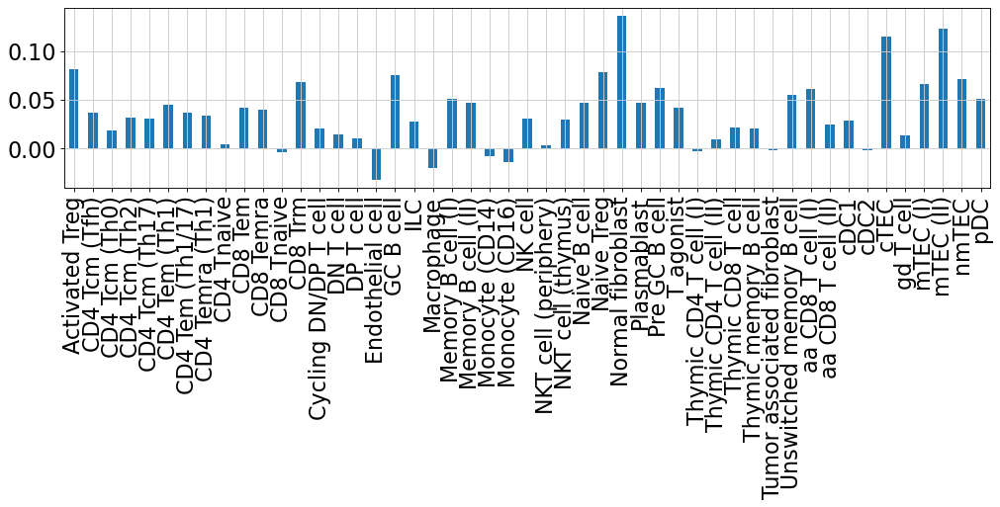

In [31]:
plt.figure(figsize=(15,3))
df_stats['mean_GWAS'].plot.bar()

<AxesSubplot:>

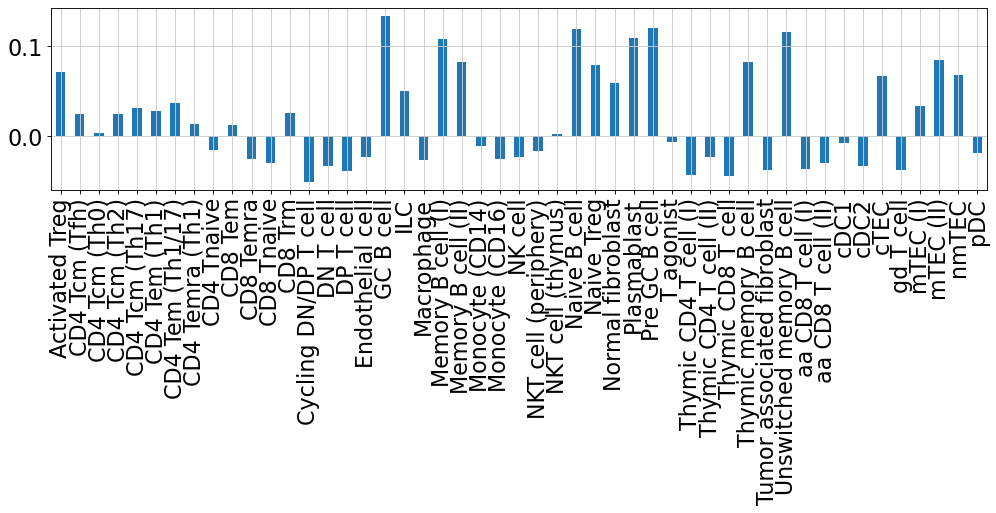

In [32]:
plt.figure(figsize=(15,3))
df_stats['mean_GWAS_LD'].plot.bar()

In [47]:
df_stats.loc[df_stats['mean_GWAS']>0].sort_values(by='pval_GWAS')

,mean_black,pval_black,padj_black,mean_turquoise,pval_turquoise,padj_turquoise,mean_blue,pval_blue,padj_blue,mean_yellow,...,padj_grey,mean_autoantibodies,pval_autoantibodies,padj_autoantibodies,mean_GWAS,pval_GWAS,padj_GWAS,mean_GWAS_LD,pval_GWAS_LD,padj_GWAS_LD
Naive B cell,-0.016740,8.648558e-131,0.000000e+00,-0.077396,9.871373e-34,0.000000e+00,-0.011686,0.000000e+00,0.000000e+00,-0.031386,...,0.000000e+00,0.002887,0.000000e+00,0.000000e+00,0.046673,6.325943e-87,0.000000e+00,0.118946,0.000000e+00,0.000000e+00
Normal fibroblast,0.026265,1.730622e-32,0.000000e+00,0.068864,0.000000e+00,0.000000e+00,-0.028637,2.106403e-82,0.000000e+00,-0.001987,...,4.697706e-09,-0.009899,4.094214e-01,6.512169e-01,0.136269,4.266607e-69,0.000000e+00,0.059621,3.649614e-14,1.022737e-12
DP T cell,-0.003812,2.759309e-02,3.049365e-01,-0.081421,3.735959e-02,4.562172e-01,0.101899,0.000000e+00,0.000000e+00,-0.031188,...,0.000000e+00,0.000482,0.000000e+00,0.000000e+00,0.010439,5.160017e-58,0.000000e+00,-0.038135,0.000000e+00,0.000000e+00
Naive Treg,-0.006056,2.775987e-01,9.720383e-01,-0.084203,6.913946e-04,1.305507e-02,0.017897,3.860695e-25,0.000000e+00,-0.032610,...,0.000000e+00,-0.014831,3.682365e-14,1.290079e-12,0.077974,1.397343e-48,0.000000e+00,0.079077,1.065068e-63,0.000000e+00
CD4 Tnaive,-0.019163,1.628578e-220,0.000000e+00,-0.079519,2.218208e-08,5.767340e-07,0.021119,4.543077e-184,0.000000e+00,-0.027716,...,0.000000e+00,-0.013325,2.720779e-77,0.000000e+00,0.004115,2.931756e-47,0.000000e+00,-0.015578,1.280354e-19,0.000000e+00
aa CD8 T cell (I),0.004410,2.307192e-15,6.294965e-14,-0.081200,8.683079e-01,9.996992e-01,0.056226,2.912562e-27,0.000000e+00,-0.030419,...,6.251873e-01,-0.010172,1.686413e-02,1.419316e-01,0.061552,1.786594e-46,0.000000e+00,-0.036181,3.576715e-22,0.000000e+00
Unswitched memory B cell,-0.014336,2.646066e-26,0.000000e+00,-0.083380,4.664594e-05,9.791080e-04,-0.012392,0.000000e+00,0.000000e+00,-0.036135,...,0.000000e+00,-0.017819,3.151243e-76,0.000000e+00,0.054539,1.082032e-44,0.000000e+00,0.116103,0.000000e+00,0.000000e+00
mTEC (II),0.053453,1.994723e-54,0.000000e+00,0.048280,0.000000e+00,0.000000e+00,-0.014247,7.256145e-26,0.000000e+00,-0.008295,...,1.200182e-05,-0.015807,3.104124e-04,4.955053e-03,0.123184,3.820700e-27,0.000000e+00,0.084162,2.186465e-13,5.902279e-12
Activated Treg,0.006020,3.667041e-06,7.333827e-05,-0.090567,2.268536e-12,6.351852e-11,0.018707,1.253330e-11,1.253331e-10,-0.037757,...,1.808510e-09,-0.016656,2.135253e-11,7.046317e-10,0.081053,9.880583e-26,0.000000e+00,0.071420,3.698792e-25,0.000000e+00
cTEC,0.073495,9.881215e-103,0.000000e+00,0.044607,0.000000e+00,0.000000e+00,-0.025000,1.841470e-38,0.000000e+00,0.004989,...,4.116977e-05,-0.014353,3.288186e-03,3.875239e-02,0.114568,3.173775e-24,0.000000e+00,0.067425,1.202991e-09,2.887179e-08


In [48]:
df_stats.loc[df_stats['mean_GWAS_LD']>0].sort_values(by='pval_GWAS_LD')

,mean_black,pval_black,padj_black,mean_turquoise,pval_turquoise,padj_turquoise,mean_blue,pval_blue,padj_blue,mean_yellow,...,padj_grey,mean_autoantibodies,pval_autoantibodies,padj_autoantibodies,mean_GWAS,pval_GWAS,padj_GWAS,mean_GWAS_LD,pval_GWAS_LD,padj_GWAS_LD
Unswitched memory B cell,-0.014336,2.646066e-26,0.000000e+00,-0.083380,4.664594e-05,9.791080e-04,-0.012392,0.000000e+00,0.000000e+00,-0.036135,...,0.000000e+00,-0.017819,3.151243e-76,0.000000e+00,0.054539,1.082032e-44,0.000000e+00,0.116103,0.000000e+00,0.000000e+00
Naive B cell,-0.016740,8.648558e-131,0.000000e+00,-0.077396,9.871373e-34,0.000000e+00,-0.011686,0.000000e+00,0.000000e+00,-0.031386,...,0.000000e+00,0.002887,0.000000e+00,0.000000e+00,0.046673,6.325943e-87,0.000000e+00,0.118946,0.000000e+00,0.000000e+00
Memory B cell (I),-0.019931,4.916939e-39,0.000000e+00,-0.080590,4.843031e-01,9.811909e-01,-0.012428,4.642593e-224,0.000000e+00,-0.033874,...,0.000000e+00,-0.019493,1.081460e-66,0.000000e+00,0.050578,2.185095e-22,0.000000e+00,0.107804,1.105035e-189,0.000000e+00
Pre GC B cell,-0.015985,2.599460e-09,6.498649e-08,-0.083501,3.905697e-02,4.562172e-01,-0.009951,8.079035e-77,0.000000e+00,-0.035281,...,2.476696e-10,-0.007227,1.254992e-01,5.266352e-01,0.062105,1.203786e-16,3.774758e-15,0.120154,2.175497e-88,0.000000e+00
Plasmablast,-0.012402,1.161321e-04,2.088315e-03,-0.069288,2.931266e-21,0.000000e+00,-0.011702,2.204537e-72,0.000000e+00,-0.027593,...,4.132694e-12,-0.008925,8.973416e-01,8.973416e-01,0.046695,1.337246e-06,3.343060e-05,0.108705,3.190219e-64,0.000000e+00
GC B cell,-0.006360,4.412673e-01,9.970349e-01,-0.081289,8.959926e-01,9.996992e-01,-0.013121,3.165271e-51,0.000000e+00,-0.034457,...,5.933444e-04,-0.004070,4.015870e-04,6.006900e-03,0.075537,4.505087e-17,0.000000e+00,0.133594,6.761331e-64,0.000000e+00
Naive Treg,-0.006056,2.775987e-01,9.720383e-01,-0.084203,6.913946e-04,1.305507e-02,0.017897,3.860695e-25,0.000000e+00,-0.032610,...,0.000000e+00,-0.014831,3.682365e-14,1.290079e-12,0.077974,1.397343e-48,0.000000e+00,0.079077,1.065068e-63,0.000000e+00
Memory B cell (II),-0.003188,4.610995e-01,9.970349e-01,-0.083491,1.471144e-02,2.227183e-01,-0.014238,1.067937e-126,0.000000e+00,-0.035767,...,0.000000e+00,-0.017714,1.842452e-25,0.000000e+00,0.046391,1.433243e-09,4.156405e-08,0.082009,1.485023e-59,0.000000e+00
CD4 Tem (Th1/17),-0.004296,9.110244e-01,9.984098e-01,-0.084909,1.138976e-12,3.303036e-11,0.014411,6.542679e-94,0.000000e+00,-0.034490,...,0.000000e+00,-0.015815,3.215565e-51,0.000000e+00,0.036551,1.427566e-11,4.710978e-10,0.037216,2.795940e-44,0.000000e+00
Thymic memory B cell,-0.003721,7.356257e-01,9.984098e-01,-0.071313,3.711577e-16,1.099121e-14,-0.015023,3.215059e-88,0.000000e+00,-0.026411,...,6.434575e-01,-0.013901,9.593440e-07,2.014603e-05,0.020934,9.538584e-01,9.977191e-01,0.082913,1.834257e-41,0.000000e+00


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:04:46)


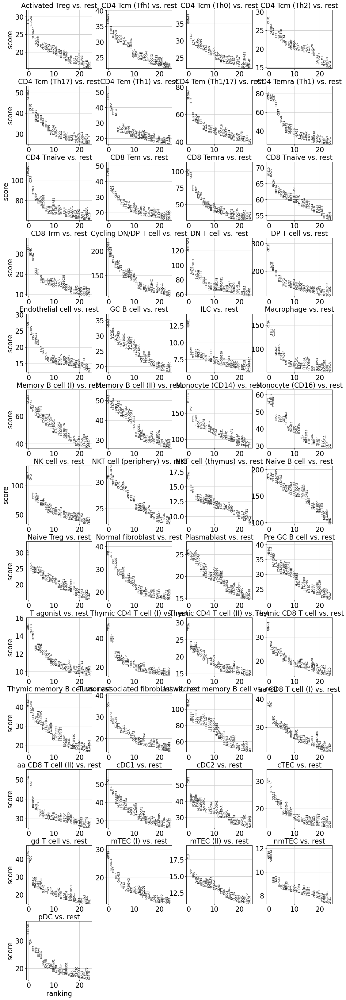

In [78]:
sc.tl.rank_genes_groups(adata, 'minor_cluster', method='t-test_overestim_var')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_minor_cluster']`


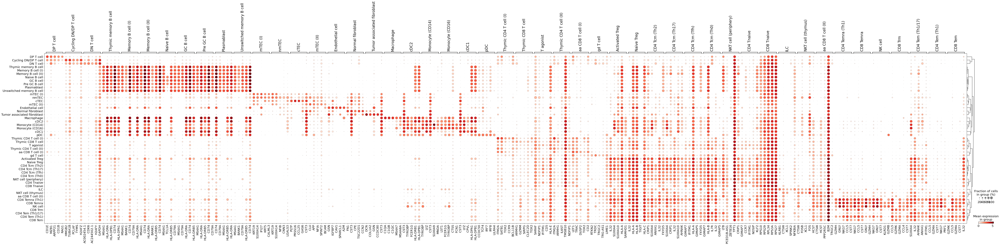

In [79]:
sc.tl.dendrogram(adata, groupby='minor_cluster')
sc.pl.rank_genes_groups_dotplot(adata, groupby='minor_cluster', n_genes=5, save='minor_auto')

In [19]:
df_marker = pd.read_csv('210430_clusters/markergenes_manual.csv', index_col = 0)
dict_markers = {pos:[row[0], row[1], row[2], row[3], row[4]] for pos,row in df_marker.iterrows()}
df_marker

,0,1,2,3,4
cluster,,,,,
Endothelial cell,PECAM1,VWF,A2M,ADGRF5,AQP1
Tumor associated fibroblast,PDGFRA,ADH1B,FBN1,COL1A1,S100A4
Normal fibroblast,FN1,EGFL6,MATN4,PTN,VIM
cTEC,CCL25,PSMB11,LY75,PRSS16,PMP22
mTEC (I),KRT15,IFI27,MT1X,CBR3,GPX2
mTEC (II),CLDN4,SDC4,CLU,STEAP4,ALPI
nmTEC,GABRA5,NEFL,KRT15,KRT6C,IFI6
NK cell,GNLY,NKG7,TYROBP,KLRF1,GNLY
NKT cell (thymus),XCL1,FOSB,JUN,XCL2,HSPA1A


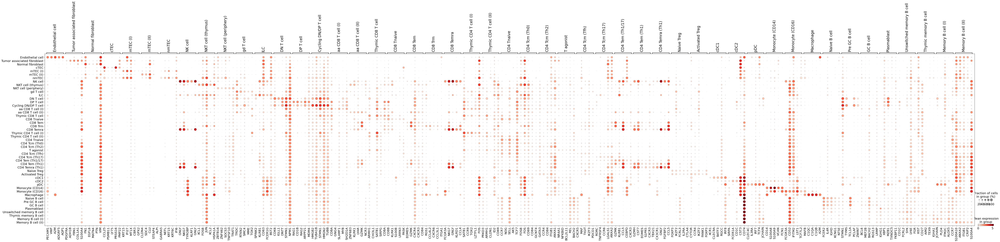

In [20]:
sc.pl.dotplot(adata, dict_markers, 'minor_cluster', categories_order=df_marker.index,
              dendrogram=False, save='minor_manual_5')

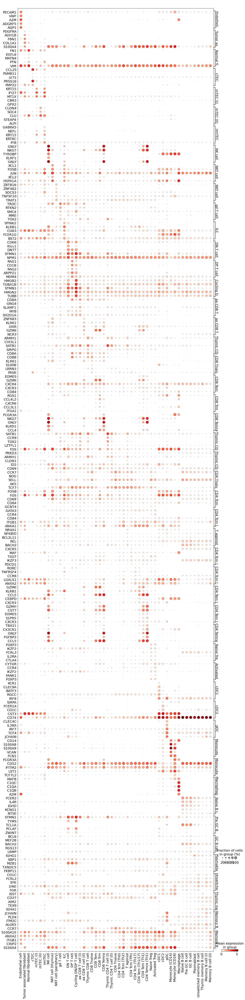

In [21]:
sc.pl.dotplot(adata, dict_markers, 'minor_cluster', categories_order=df_marker.index, swap_axes=True,
              dendrogram=False, save='minor_manual_5_vertical')

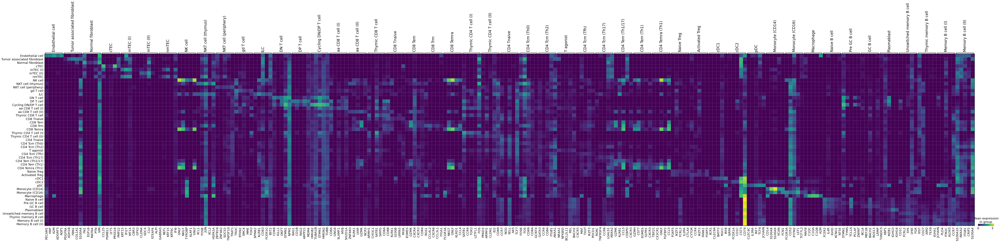

In [83]:
dict_markers = {pos:[row[0], row[1], row[2], row[3], row[4]] for pos,row in df_marker.iterrows()}
sc.pl.matrixplot(adata, dict_markers, 'minor_cluster', categories_order=df_marker.index, dendrogram=False, save='minor_manual_5')

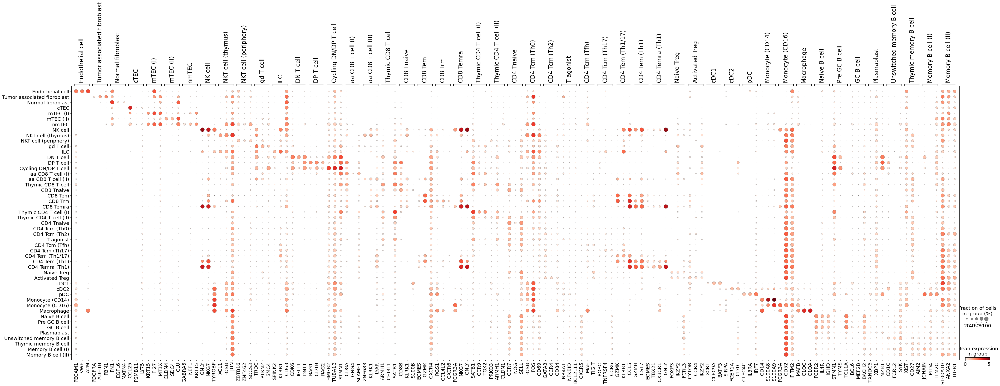

In [84]:
dict_markers = {pos:[row[0], row[1], row[2]] for pos,row in df_marker.iterrows()}
sc.pl.dotplot(adata, dict_markers, 'minor_cluster', categories_order=df_marker.index, dendrogram=False, save='minor_manual_3')

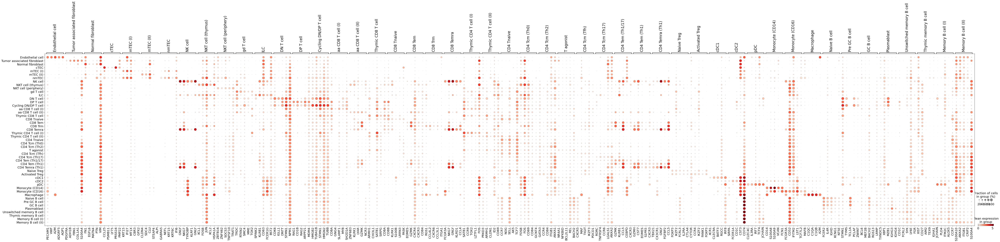

In [85]:
dict_markers = {pos:[row[0], row[1], row[2], row[3], row[4]] for pos,row in df_marker.iterrows()}
sc.pl.dotplot(adata, dict_markers, 'minor_cluster', categories_order=df_marker.index, 
              dendrogram=False, save='minor_manual_5')

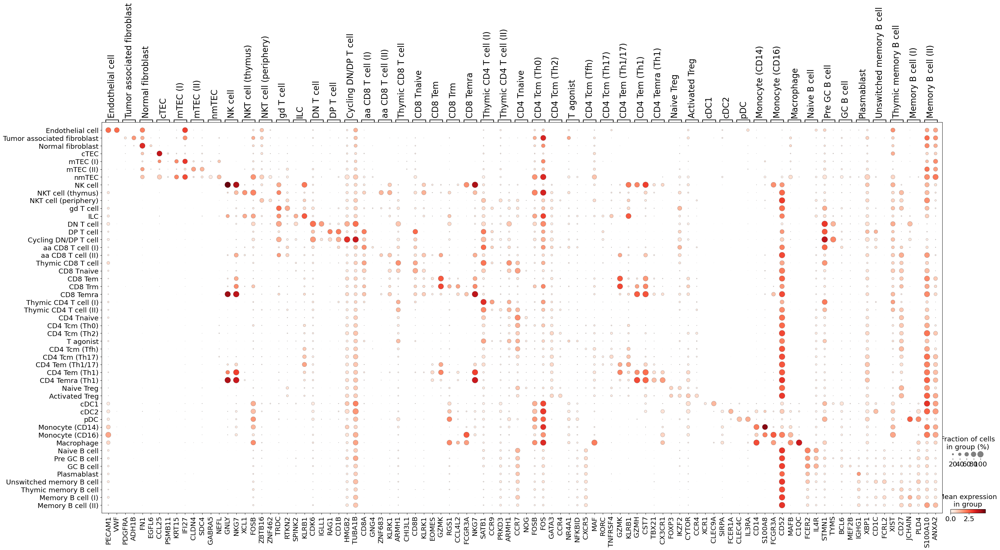

In [23]:
dict_markers = {pos:[row[0], row[1]] for pos,row in df_marker.iterrows()}
sc.pl.dotplot(adata, dict_markers, 'minor_cluster', categories_order=df_marker.index, 
              dendrogram=False, save='minor_manual_2')

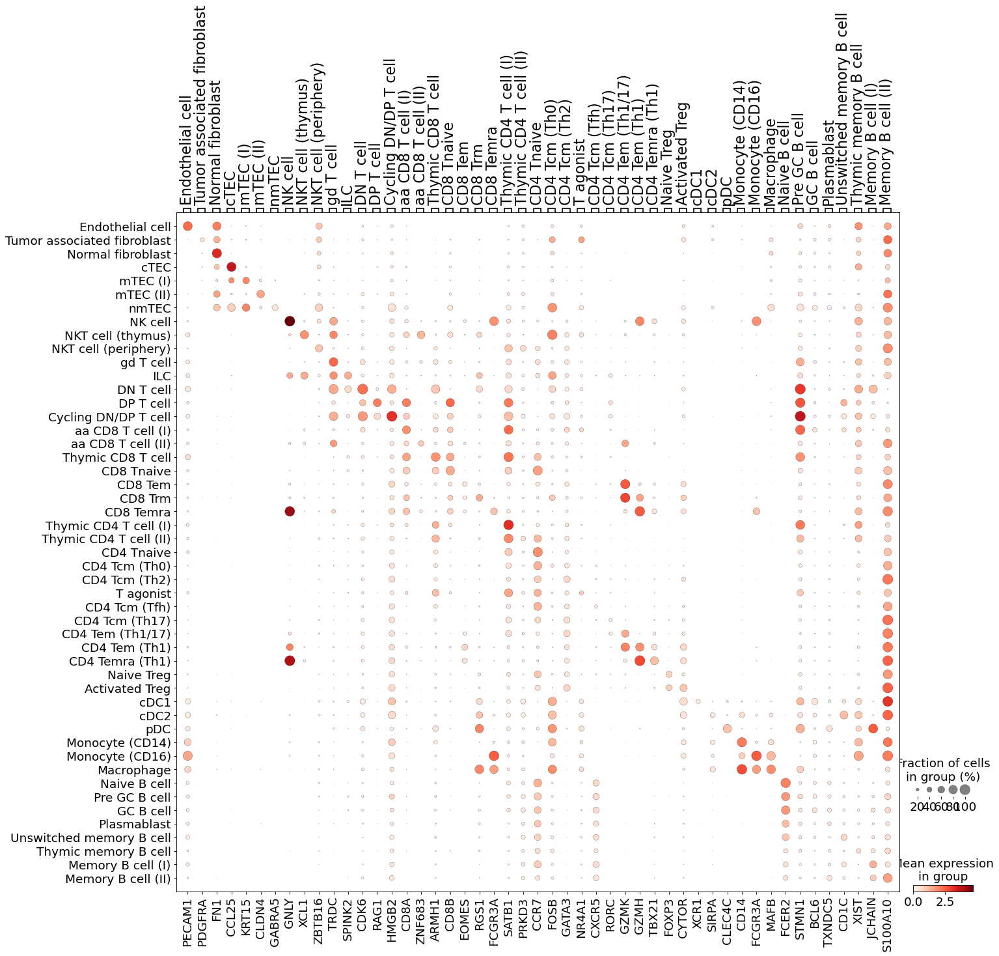

In [87]:
dict_markers = {pos:[row[0]] for pos,row in df_marker.iterrows()}
sc.pl.dotplot(adata, dict_markers, 'minor_cluster', categories_order=df_marker.index, 
              dendrogram=False, save='minor_manual_1')

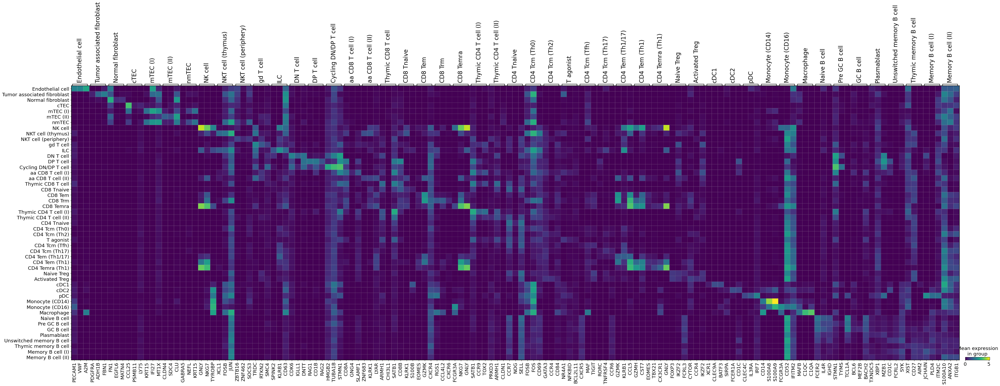

In [88]:
dict_markers = {pos:[row[0], row[1], row[2]] for pos,row in df_marker.iterrows()}
sc.pl.matrixplot(adata, dict_markers, 'minor_cluster', categories_order=df_marker.index, dendrogram=False, save='minor_manual_3')

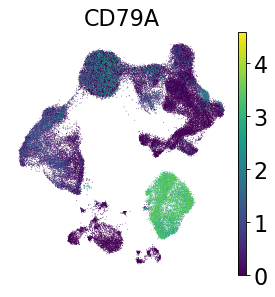

In [89]:
sc.pl.umap(adata, color='CD79A')

In [90]:
list_chemokines = (pd.read_csv('data/chemokines.txt', skiprows=1)['Approved symbol'])
list_chemokine_receptors = list(pd.read_csv('data/chemokine_receptors.txt', sep='\t')['Approved symbol'])

list_chemokines = [x for x in list_chemokines if x in adata.raw.var.index]
list_chemokine_receptors = [x for x in list_chemokine_receptors if x in adata.raw.var.index]

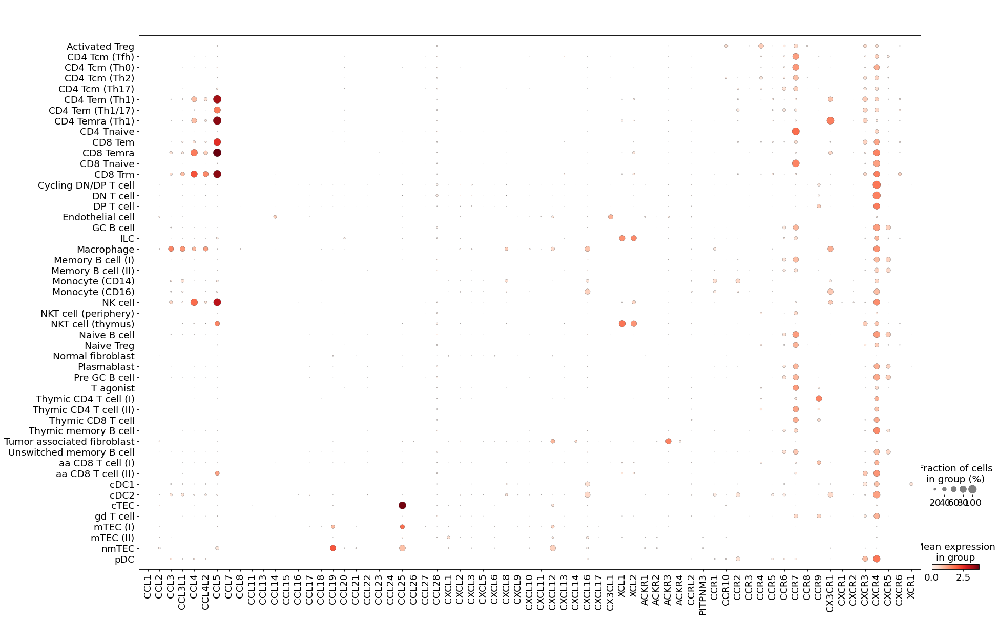

In [91]:
sc.pl.dotplot(adata, list_chemokines+list_chemokine_receptors, groupby='minor_cluster',
              save='chemokine_chemokineR_all')

In [92]:
def grouped_obs_mean(adata, group_key, layer=None, gene_symbols=None):
    if layer is not None:
        getX = lambda x: x.layers[layer]
    else:
        getX = lambda x: x.X
    if gene_symbols is not None:
        new_idx = adata.var[idx]
    else:
        new_idx = adata.var_names

    grouped = adata.obs.groupby(group_key)
    out = pd.DataFrame(
        np.zeros((adata.shape[1], len(grouped)), dtype=np.float64),
        columns=list(grouped.groups.keys()),
        index=adata.var_names
    )

    for group, idx in grouped.indices.items():
        X = getX(adata[idx])
        out[group] = np.ravel(X.mean(axis=0, dtype=np.float64))
    return out

In [93]:
mean_exp = grouped_obs_mean(adata.raw.to_adata(), 'minor_cluster')

In [94]:
mean_exp

,Activated Treg,CD4 Tcm (Tfh),CD4 Tcm (Th0),CD4 Tcm (Th2),CD4 Tcm (Th17),CD4 Tem (Th1),CD4 Tem (Th1/17),CD4 Temra (Th1),CD4 Tnaive,CD8 Tem,...,aa CD8 T cell (I),aa CD8 T cell (II),cDC1,cDC2,cTEC,gd T cell,mTEC (I),mTEC (II),nmTEC,pDC
MIR1302-2HG,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
FAM138A,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
OR4F5,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AL627309.1,0.002373,0.000000,0.000600,0.0,0.002363,0.0,0.001808,0.001473,0.000757,0.000000,...,0.003643,0.001936,0.000000,0.000000,0.000000,0.001802,0.000000,0.000000,0.000000,0.006923
AL627309.3,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.001136,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC141272.1,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AC023491.2,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AC007325.1,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000186,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AC007325.4,0.000000,0.002715,0.004665,0.0,0.004953,0.0,0.000632,0.000000,0.001925,0.002391,...,0.004323,0.003434,0.014804,0.002773,0.073302,0.002974,0.031577,0.050783,0.019176,0.003214


In [95]:
list_ch_exp = [x for x in list_chemokines if mean_exp.max(axis=1)[x] >= 0.1]
list_chr_exp = [x for x in list_chemokine_receptors if mean_exp.max(axis=1)[x] >= 0.1]

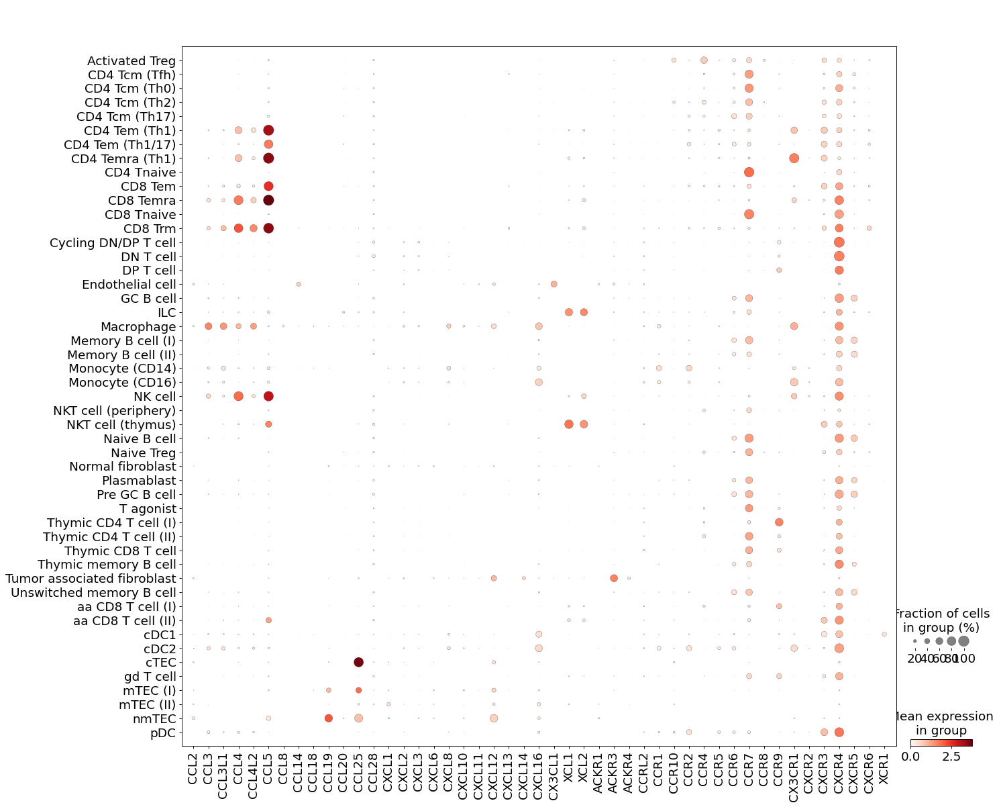

In [96]:
sc.pl.dotplot(adata, list_ch_exp+list_chr_exp, groupby='minor_cluster',
              save='chemokine_chemokineR')

In [97]:
mean_exp.loc['CXCL13']

Activated Treg                 0.000000
CD4 Tcm (Tfh)                  0.178536
CD4 Tcm (Th0)                  0.000000
CD4 Tcm (Th2)                  0.000000
CD4 Tcm (Th17)                 0.000000
CD4 Tem (Th1)                  0.016188
CD4 Tem (Th1/17)               0.000000
CD4 Temra (Th1)                0.000000
CD4 Tnaive                     0.000000
CD8 Tem                        0.090171
CD8 Temra                      0.000000
CD8 Tnaive                     0.000000
CD8 Trm                        0.248485
Cycling DN/DP T cell           0.002834
DN T cell                      0.000190
DP T cell                      0.004419
Endothelial cell               0.000000
GC B cell                      0.000000
ILC                            0.009659
Macrophage                     0.000000
Memory B cell (I)              0.000000
Memory B cell (II)             0.003686
Monocyte (CD14)                0.002587
Monocyte (CD16)                0.000000
NK cell                        0.000000


In [98]:
mean_exp.columns

Index(['Activated Treg', 'CD4 Tcm (Tfh)', 'CD4 Tcm (Th0)', 'CD4 Tcm (Th2)',
       'CD4 Tcm (Th17)', 'CD4 Tem (Th1)', 'CD4 Tem (Th1/17)',
       'CD4 Temra (Th1)', 'CD4 Tnaive', 'CD8 Tem', 'CD8 Temra', 'CD8 Tnaive',
       'CD8 Trm', 'Cycling DN/DP T cell', 'DN T cell', 'DP T cell',
       'Endothelial cell', 'GC B cell', 'ILC', 'Macrophage',
       'Memory B cell (I)', 'Memory B cell (II)', 'Monocyte (CD14)',
       'Monocyte (CD16)', 'NK cell', 'NKT cell (periphery)',
       'NKT cell (thymus)', 'Naive B cell', 'Naive Treg', 'Normal fibroblast',
       'Plasmablast', 'Pre GC B cell', 'T agonist', 'Thymic CD4 T cell (I)',
       'Thymic CD4 T cell (II)', 'Thymic CD8 T cell', 'Thymic memory B cell',
       'Tumor associated fibroblast', 'Unswitched memory B cell',
       'aa CD8 T cell (I)', 'aa CD8 T cell (II)', 'cDC1', 'cDC2', 'cTEC',
       'gd T cell', 'mTEC (I)', 'mTEC (II)', 'nmTEC', 'pDC'],
      dtype='object')

In [99]:
list_clusters = ['Thymic CD4 T cell (I)', 'Thymic CD4 T cell (II)', 'CD4 Tnaive', 'CD4 Tcm (Th0)', 'CD4 Tcm (Tfh)', 'CD4 Tcm (Th2)',
       'CD4 Tcm (Th17)', 'CD4 Tem (Th1)', 'CD4 Tem (Th1/17)',
       'CD4 Temra (Th1)', 'Naive Treg','Activated Treg', 
       'Naive B cell', 'GC B cell', 'Pre GC B cell', 'Thymic memory B cell', 'Unswitched memory B cell', 
     'Memory B cell (I)', 'Memory B cell (II)', 
       'Plasmablast', 'mTEC (I)', 'mTEC (II)', 'nmTEC', 'cTEC',
       'Endothelial cell', 'Normal fibroblast', 'Tumor associated fibroblast']
list_genes = ['CCL25', 'CCR9', 'CCL19', 'CCR7', 'CXCL12', 'CXCR4', 'IL7', 'IL7R', 'CD40LG', 'CD40', 'VEGFA', 'FLT1', 
             'VEGFC', 'FLT4', 'PDGFA', 'PDGFRA']


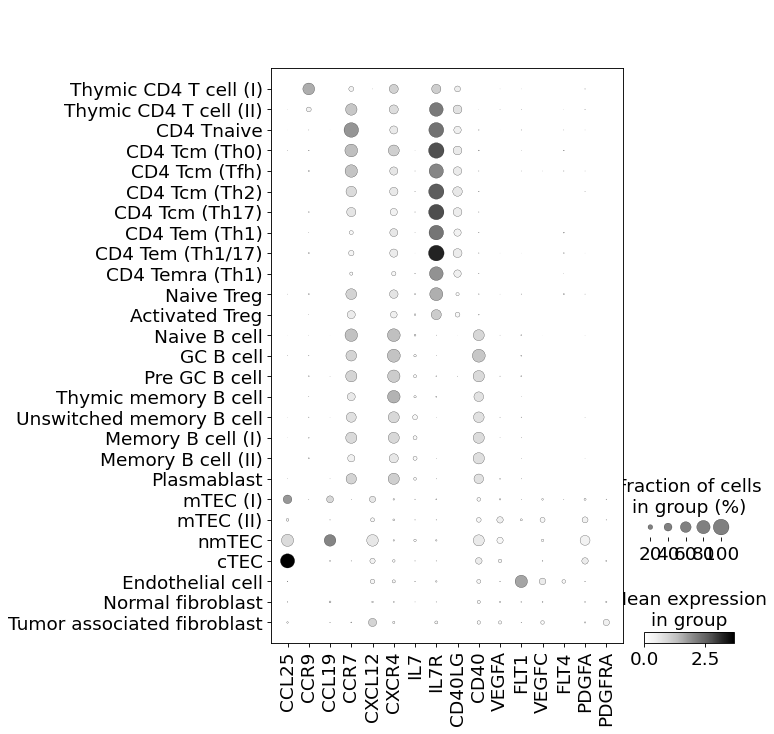

In [100]:
sc.pl.dotplot(adata[adata.obs.minor_cluster.isin(list_clusters)], list_genes, groupby='minor_cluster', 
              categories_order=list_clusters, cmap='Greys', save='ligand_receptor_tbtec')

In [17]:
adata = sc.read(results_file_minor_cluster)

In [105]:
list_clusters = ['Thymic CD4 T cell (I)', 'Thymic CD4 T cell (II)', 'CD4 Tnaive', 'CD4 Tcm (Th0)', 'CD4 Tcm (Tfh)', 'CD4 Tcm (Th2)',
       'CD4 Tcm (Th17)', 'CD4 Tem (Th1)', 'CD4 Tem (Th1/17)',
       'CD4 Temra (Th1)', 'Naive Treg','Activated Treg', 
       'Naive B cell', 'GC B cell', 'Pre GC B cell', 'Thymic memory B cell', 'Unswitched memory B cell', 
     'Memory B cell (I)', 'Memory B cell (II)', 
       'Plasmablast', 'mTEC (I)', 'mTEC (II)', 'nmTEC', 'cTEC',
       'Endothelial cell', 'Normal fibroblast', 'Tumor associated fibroblast']
list_genes = ['CCL25', 'CCR9', 'CCL19', 'CCR7', 'CXCL12', 'CXCR4', 'CXCL13', 'CXCR5', 'IL7', 'IL7R', 'CD40LG', 'CD40', 'VEGFA', 'FLT1', 
             'VEGFC', 'FLT4', 'PDGFA', 'PDGFRA']


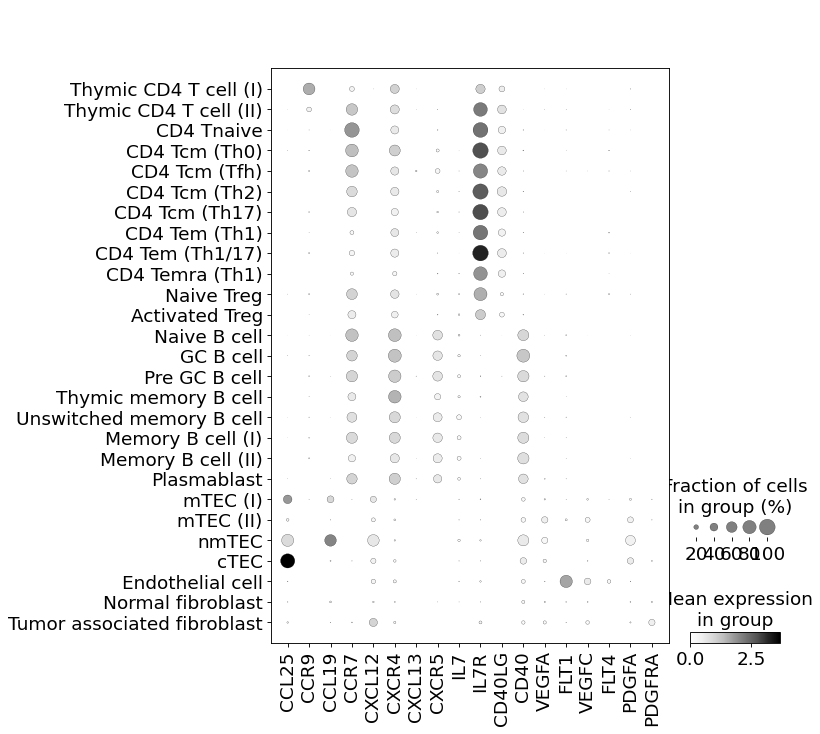

In [106]:
sc.pl.dotplot(adata[adata.obs.minor_cluster.isin(list_clusters)], list_genes, groupby='minor_cluster', 
              categories_order=list_clusters, cmap='Greys', save='ligand_receptor_tbtec2')

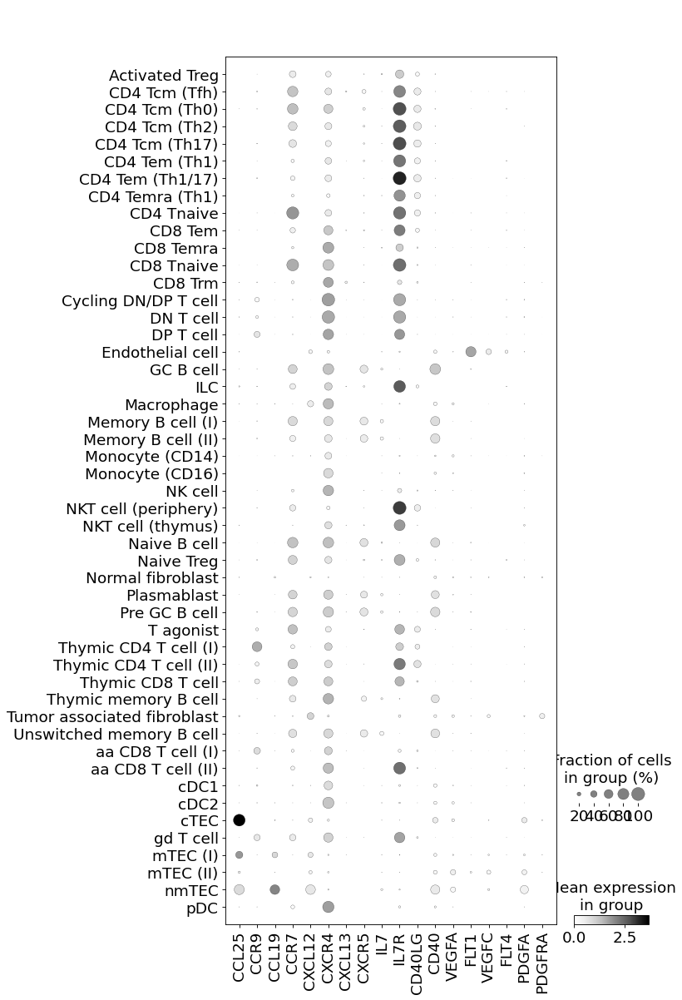

In [107]:
sc.pl.dotplot(adata, list_genes, groupby='minor_cluster',  cmap='Greys', save='ligand_receptor_tbtec2_all')

In [51]:
adata.obs.major_cluster

AAACCCACAACAGCTT    Cycling DN/DP T cell
AAACCCACAGAGATGC               DP T cell
AAACCCATCCGTAATG               DN T cell
AAACGAAAGGGTCACA               DN T cell
AAACGAAGTCACCGCA            Stromal cell
                            ...         
TTTGTTGCACACCAGC            Myeloid cell
TTTGTTGGTGTGATGG    Cycling DN/DP T cell
TTTGTTGGTTAAACCC    Cycling DN/DP T cell
TTTGTTGGTTTGTTCT               DP T cell
TTTGTTGTCTCTATAC               DP T cell
Name: major_cluster, Length: 64649, dtype: category
Categories (7, object): ['B cell', 'Cycling DN/DP T cell', 'DN T cell', 'DP T cell', 'Myeloid cell', 'Stromal cell', 'T cell']

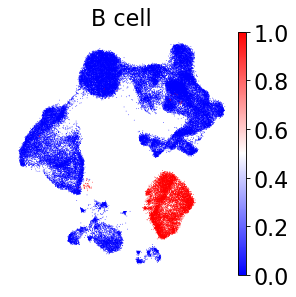

In [77]:
clu = 'B cell'
adata.obs[clu] = (adata.obs.major_cluster == clu).astype(int)
sc.pl.umap(adata, color=clu, save=clu.replace(' ', ''), cmap='bwr')

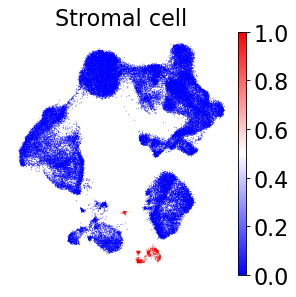

In [78]:
clu = 'Stromal cell'
adata.obs[clu] = (adata.obs.major_cluster == clu).astype(int)
sc.pl.umap(adata, color=clu, save=clu.replace(' ', ''), cmap='bwr')

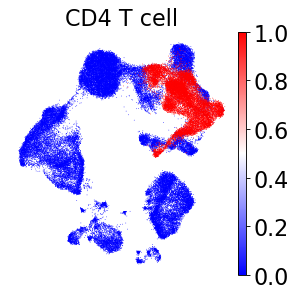

In [79]:
clu = 'CD4 T cell'
cd4t = ['Naive Treg', 'Thymic CD8 T cell', 'Thymic CD4 T cell (II)', 'CD4 Tcm (Th17)', 'CD4 Tnaive', 
        'Thymic CD4 T cell (I)', 'CD4 Tcm (Tfh)', 'CD4 Tcm (Th0)', 'T agonist', 'CD4 Tcm (Th2)',
        'CD4 Tem (Th1)', 'CD4 Tem (Th1/17)', 'Activated Treg', 'CD4 Temra (Th1)']
adata.obs[clu] = (adata.obs.minor_cluster.isin(cd4t)).astype(int)
sc.pl.umap(adata, color=clu, save=clu.replace(' ', ''), cmap='bwr')

In [68]:
for c in adata[adata.obs.major_cluster=='T cell'].obs.minor_cluster.unique():
    
    print(c)

Naive Treg
Thymic CD8 T cell
Thymic CD4 T cell (II)
CD4 Tcm (Th17)
CD4 Tnaive
aa CD8 T cell (I)
gd T cell
Thymic CD4 T cell (I)
CD8 Trm
ILC
CD8 Tem
DP T cell
CD4 Tcm (Tfh)
aa CD8 T cell (II)
NK cell
CD4 Tcm (Th0)
NKT cell (periphery)
CD8 Tnaive
NKT cell (thymus)
CD8 Temra
T agonist
CD4 Tcm (Th2)
CD4 Tem (Th1)
CD4 Tem (Th1/17)
Activated Treg
CD4 Temra (Th1)


In [102]:
adata.write(results_file_minor_cluster)

In [103]:
adata = sc.read(results_file_minor_cluster)
adata_raw = sc.read(results_raw_file)

adata_cg = adata_raw[adata.obs.index].copy()
adata_cg.obs = adata.obs
adata_cg.obsm = adata.obsm
adata_cg.uns = adata.uns

sc.pp.normalize_per_cell(adata_cg, counts_per_cell_after=1e4)
sc.pp.log1p(adata_cg)

adata_cg.write(results_file_cg_minor_cluster)

normalizing by total count per cell
    finished (0:00:13): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


## cellphoneDB

In [108]:
adata

AnnData object with n_obs × n_vars = 64649 × 1506
    obs: 'sample', 'sample_type', 'site', 'fraction', 'n_genes', 'individual', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'leiden_R', 'major_cluster', 'minor_cluster', 'score_GWAS_wo_HLA', 'score_autoantibodies', 'score_GWAS', 'score_black', 'score_turquoise', 'score_blue', 'score_yellow', 'score_green', 'score_red', 'score_grey'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'dendrogram_minor_cluster', 'individual_colors', 'leiden', 'leiden_R_colors', 'leiden_colors', 'major_cluster_colors', 'minor_cluster_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_colors', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [109]:
df_features = pd.read_csv('data/cellranger/MG03_PB/filtered_feature_bc_matrix/features.tsv.gz', 
                          sep='\t', header=None)
df_features.columns = ['ensembl', 'symbol', 'ge']
df_features = df_features.drop_duplicates(subset=['symbol'])
df_features.index = df_features['symbol']

In [110]:
adata.raw.var['ensembl'] = df_features.reindex(adata.raw.var.index)['ensembl']

In [111]:
df_X = pd.DataFrame(adata.raw.X.todense())
df_X.index = adata.obs.index
df_X.columns = adata.raw.var['ensembl'].str.split('.').str.get(0)

In [112]:
import os

os.makedirs('cellphonedb/{}'.format(version), exist_ok=True)

In [ ]:
df_X.T.to_csv('cellphonedb/{}/exp.csv'.format(version))

In [ ]:
adata.obs['minor_cluster'].to_csv('cellphonedb/{}/meta.csv'.format(version))

```
cd ~/media32TB/bioinformatics/MG_scRNAseq/cellphonedb/210711_merged_thymoma_MG21.22.23.03

cellphonedb method statistical_analysis meta.csv exp.csv

cellphonedb plot dot_plot

cellphonedb plot heatmap_plot meta.csv

cellphonedb plot dot_plot --rows out/angiogenesis/rows.txt --columns out/angiogenesis/cols.txt --output-path out/angiogenesis
```

In [4]:
df_count = pd.read_csv('cellphonedb/{}/out/count_network.txt'.format(version), sep='\t')
df_count.head()

,SOURCE,TARGET,count
0,Cycling DN/DP T cell,Cycling DN/DP T cell,10
1,Cycling DN/DP T cell,DP T cell,13
2,Cycling DN/DP T cell,DN T cell,19
3,Cycling DN/DP T cell,mTEC (I),14
4,Cycling DN/DP T cell,Unswitched memory B cell,42


In [5]:
list_int = []
for pos, row in df_count.iterrows():
    s = row['SOURCE']
    t = row['TARGET']
    
    if len([x for x in list_int if (x[1]==s) & (x[0]==t)]) == 0:
#         c = row['count'] + df_count.query('SOURCE==@t & TARGET==@s')['count'].iloc[0]
        list_int.append([row['SOURCE'], row['TARGET'], row['count']])

In [6]:
df_count_sum = pd.DataFrame(list_int, columns = ['source', 'target', 'count'])
df_count_sum.head()

,source,target,count
0,Cycling DN/DP T cell,Cycling DN/DP T cell,10
1,Cycling DN/DP T cell,DP T cell,13
2,Cycling DN/DP T cell,DN T cell,19
3,Cycling DN/DP T cell,mTEC (I),14
4,Cycling DN/DP T cell,Unswitched memory B cell,42


In [7]:
df_count_sum.to_csv('cellphonedb/{}/out/count_network_dropdup.txt'.format(version), sep='\t')

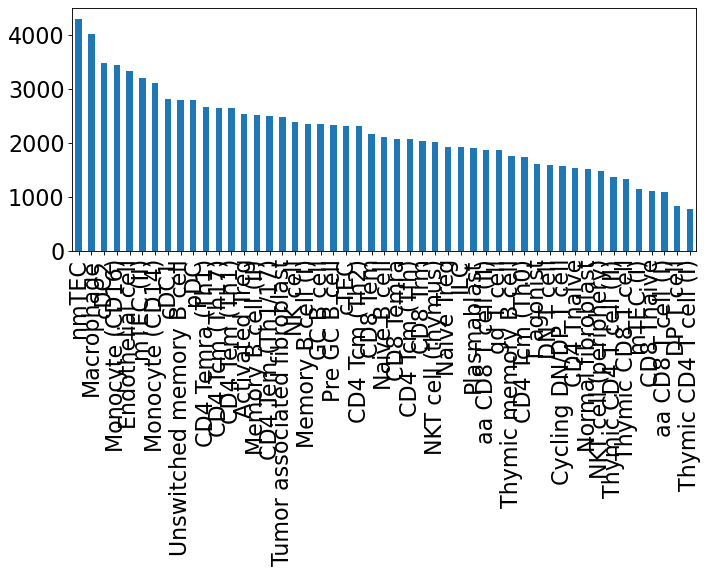

In [8]:
plt.figure(figsize=(10,4))
pd.read_csv('cellphonedb/{}/out/interaction_count.txt'.format(version), sep='\t', 
            index_col=0)['all_sum'].sort_values(ascending=False).plot.bar()
plt.grid(False)
plt.savefig('cellphonedb/{}/out/num_interaction.pdf'.format(version), bbox_inches='tight')

In [9]:
df_network = pd.read_csv('cellphonedb/{}/out/count_network.txt'.format(version), sep='\t', 
            index_col=None)
df_network

,SOURCE,TARGET,count
0,Cycling DN/DP T cell,Cycling DN/DP T cell,10
1,Cycling DN/DP T cell,DP T cell,13
2,Cycling DN/DP T cell,DN T cell,19
3,Cycling DN/DP T cell,mTEC (I),14
4,Cycling DN/DP T cell,Unswitched memory B cell,42
...,...,...,...
2396,CD4 Temra (Th1),CD4 Tem (Th1/17),64
2397,CD4 Temra (Th1),Activated Treg,66
2398,CD4 Temra (Th1),cTEC,54
2399,CD4 Temra (Th1),Monocyte (CD16),86


In [10]:
df_network.loc[(df_network['SOURCE'] == 'nmTEC')].sort_values(by='count', ascending=False)

,SOURCE,TARGET,count
1051,nmTEC,mTEC (II),201
1035,nmTEC,Endothelial cell,183
1047,nmTEC,Tumor associated fibroblast,183
1050,nmTEC,nmTEC,173
1075,nmTEC,cTEC,154
1053,nmTEC,Macrophage,139
1055,nmTEC,cDC2,131
1076,nmTEC,Monocyte (CD16),115
1046,nmTEC,cDC1,114
1057,nmTEC,pDC,112


In [11]:
df_network.loc[(df_network['SOURCE'] == 'mTEC')]

,SOURCE,TARGET,count


<AxesSubplot:>

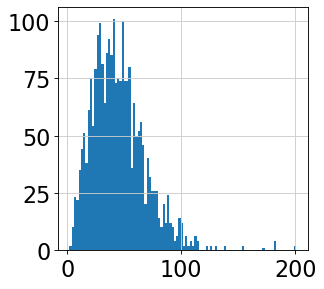

In [12]:
df_network['count'].hist(bins=100)

In [13]:
import networkx as nx
import matplotlib as mpl

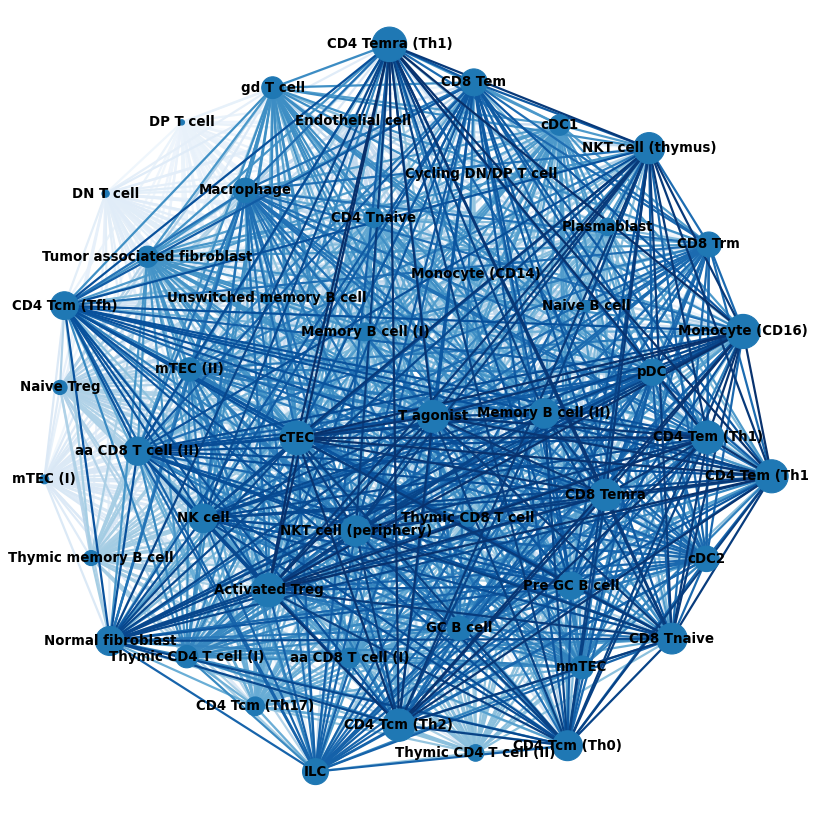

In [14]:
G = nx.from_pandas_edgelist(df_network, source='SOURCE', target='TARGET', edge_attr='count')

node_sizes = [3 + 20 * i for i in range(len(G))]
M = G.number_of_edges()
edge_colors = range(2, M + 2)
edge_alphas = [(5 + i) / (M + 4) for i in range(M)]

plt.figure(figsize=(10,10))
nx.draw(G, with_labels=True, font_weight='bold', node_size=node_sizes, 
        edge_color=edge_colors,
        edge_cmap=plt.cm.Blues, width=2)


In [241]:
color_map = []
for node, data in G.nodes(data=True):
    node

In [242]:
node

'CD4 Temra (Th1)'

In [243]:
adata

AnnData object with n_obs × n_vars = 64649 × 1506
    obs: 'sample', 'sample_type', 'site', 'fraction', 'n_genes', 'individual', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_R', 'major_cluster', 'score_DEGs', 'score_yellow', 'score_GWAS', 'score_GWAS_wo_HLA', 'minor_cluster', 'score_autoantibodies', 'score_black', 'score_turquoise', 'score_blue', 'score_green', 'score_red', 'score_grey'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'dendrogram_leiden_R', 'dendrogram_major_cluster', 'dendrogram_minor_cluster', 'individual_colors', 'leiden', 'leiden_R_colors', 'leiden_colors', 'major_cluster_colors', 'minor_cluster_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_colors', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

## scaden

In [221]:
import os

dir_scaden = './scanpy/{}/scaden'.format(version)
os.makedirs('{}/thymoma'.format(dir_scaden), exist_ok=True)

In [222]:
adata = sc.read(results_file_minor_cluster)

In [223]:
assert adata.shape[0] == adata.raw.shape[0]
df_count = np.exp(adata.raw.X.todense()) - 1
df_count = pd.DataFrame(df_count, columns = adata.raw.var.index)
df_count.to_csv('{}/thymoma/thymoma_counts.txt'.format(dir_scaden), sep='\t', index=False)
df_count.head()

,MIR1302-2HG,FAM138A,OR4F5,AL627309.1,AL627309.3,AL627309.2,AL627309.5,AL627309.4,AP006222.2,AL732372.1,...,AC133551.1,AC136612.1,AC136616.1,AC136616.3,AC136616.2,AC141272.1,AC023491.2,AC007325.1,AC007325.4,AC007325.2
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [224]:
df_celltypes = pd.DataFrame(adata.obs['minor_cluster'])
df_celltypes.columns = ['Celltype']
df_celltypes.to_csv("{}/thymoma/thymoma_celltypes.txt".format(dir_scaden), sep="\t")
df_celltypes.head()

,Celltype
AAACCCACAACAGCTT,Cycling DN/DP T cell
AAACCCACAGAGATGC,DP T cell
AAACCCATCCGTAATG,DN T cell
AAACGAAAGGGTCACA,DN T cell
AAACGAAGTCACCGCA,mTEC (I)


In [226]:
pd.read_csv('{}/201123_TCGATHYM_HTSeq_rawcounts.csv'.format(dir_scaden)).to_csv('{}/thymoma/TCGA-THYM.txt'.format(dir_scaden), sep='\t', index=False)

```
cd /home/yyasumizu/media32TB/bioinformatics/MG_scRNAseq/scanpy/210407_merged_thymoma_MG21.22.03/scaden
cp ~/media32TB/bioinformatics/TCGA_thymoma/201123_TCGATHYM_HTSeq_rawcounts.csv ./thymoma

scaden simulate --data ./thymoma -n 30000 --pattern "*_counts.txt"
scaden process data.h5ad thymoma/TCGA-THYM.txt
scaden train processed.h5ad --steps 5000 --model_dir model
scaden predict --model_dir model thymoma/TCGA-THYM.txt
```

In [245]:
df_celltypes['Celltype'].unique()

['Cycling DN/DP T cell', 'DP T cell', 'DN T cell', 'mTEC (I)', 'Unswitched memory B cell', ..., 'CD4 Tem (Th1/17)', 'Activated Treg', 'cTEC', 'Monocyte (CD16)', 'CD4 Temra (Th1)']
Length: 49
Categories (49, object): ['Cycling DN/DP T cell', 'DP T cell', 'DN T cell', 'mTEC (I)', ..., 'Activated Treg', 'cTEC', 'Monocyte (CD16)', 'CD4 Temra (Th1)']